In [1]:
#https://www.kaggle.com/datasets/zahidmughal2343/global-cancer-patients-2015-2024/data

In [2]:
# data wrangling & pre-processing
import pandas as pd
import numpy as np
# data visualization
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn.model_selection import train_test_split

#model validation
from sklearn.metrics import log_loss,roc_auc_score,precision_score,f1_score,recall_score,roc_curve,auc
from sklearn.metrics import classification_report, confusion_matrix,accuracy_score,fbeta_score,matthews_corrcoef
from sklearn import metrics
from math import pi
import matplotlib.pyplot as plt
# cross validation
from sklearn.model_selection import StratifiedKFold

# machine learning algorithms
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier,VotingClassifier,AdaBoostClassifier,GradientBoostingClassifier,RandomForestClassifier,ExtraTreesClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.svm import SVC
import xgboost as xgb

from scipy import stats

In [3]:
df = pd.read_csv('global_cancer_patients_2015_2024.csv')

In [4]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,Male,UK,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,Male,China,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,Male,Pakistan,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,Male,UK,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,Female,Brazil,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


In [5]:
df["Gender"].value_counts()  # imbalance problem

Gender
Male      16796
Female    16709
Other     16495
Name: count, dtype: int64

In [6]:
df["Cancer_Stage"].value_counts()  # imbalance problem

Cancer_Stage
Stage II     10124
Stage I      10046
Stage III    10008
Stage IV      9933
Stage 0       9889
Name: count, dtype: int64

In [7]:
df.columns

Index(['Patient_ID', 'Age', 'Gender', 'Country_Region', 'Year', 'Genetic_Risk',
       'Air_Pollution', 'Alcohol_Use', 'Smoking', 'Obesity_Level',
       'Cancer_Type', 'Cancer_Stage', 'Treatment_Cost_USD', 'Survival_Years',
       'Target_Severity_Score'],
      dtype='object')

In [8]:
df["Country_Region"].value_counts()  # imbalance problem

Country_Region
Australia    5092
UK           5060
USA          5060
India        5040
Germany      5024
Russia       5017
Brazil       5004
Pakistan     4926
China        4913
Canada       4864
Name: count, dtype: int64

In [9]:
missing_values = df.isnull()

In [10]:
total_missing = missing_values.sum()

In [11]:
percentage_missing = (missing_values.sum() / len(df)) * 100

In [12]:
print("Total Missing Values:\n", total_missing)
print("\nPercentage of Missing Values:\n", percentage_missing)

Total Missing Values:
 Patient_ID               0
Age                      0
Gender                   0
Country_Region           0
Year                     0
Genetic_Risk             0
Air_Pollution            0
Alcohol_Use              0
Smoking                  0
Obesity_Level            0
Cancer_Type              0
Cancer_Stage             0
Treatment_Cost_USD       0
Survival_Years           0
Target_Severity_Score    0
dtype: int64

Percentage of Missing Values:
 Patient_ID               0.0
Age                      0.0
Gender                   0.0
Country_Region           0.0
Year                     0.0
Genetic_Risk             0.0
Air_Pollution            0.0
Alcohol_Use              0.0
Smoking                  0.0
Obesity_Level            0.0
Cancer_Type              0.0
Cancer_Stage             0.0
Treatment_Cost_USD       0.0
Survival_Years           0.0
Target_Severity_Score    0.0
dtype: float64


In [13]:
df["Cancer_Type"].value_counts()  # imbalance problem

Cancer_Type
Colon       6376
Prostate    6308
Leukemia    6266
Liver       6249
Skin        6231
Cervical    6222
Breast      6189
Lung        6159
Name: count, dtype: int64

In [14]:
df["Age"].value_counts()  # imbalance problem

Age
77    785
82    777
32    766
36    758
63    757
     ... 
53    668
84    668
39    666
50    666
89    660
Name: count, Length: 70, dtype: int64

In [15]:
df["Gender"].value_counts()  # imbalance problem

Gender
Male      16796
Female    16709
Other     16495
Name: count, dtype: int64

In [16]:
df["Country_Region"].value_counts()  # imbalance problem

Country_Region
Australia    5092
UK           5060
USA          5060
India        5040
Germany      5024
Russia       5017
Brazil       5004
Pakistan     4926
China        4913
Canada       4864
Name: count, dtype: int64

In [17]:
df["Year"].value_counts()  # imbalance problem

Year
2016    5094
2020    5079
2019    5065
2017    5037
2015    5012
2024    4994
2021    4967
2018    4936
2023    4935
2022    4881
Name: count, dtype: int64

In [18]:
df["Genetic_Risk"].value_counts()  # imbalance problem

Genetic_Risk
8.8     555
7.1     547
0.9     545
7.5     543
4.5     535
       ... 
9.8     466
1.1     449
5.3     446
0.0     265
10.0    248
Name: count, Length: 101, dtype: int64

In [19]:
df["Air_Pollution"].value_counts()  # imbalance problem

Air_Pollution
0.8     557
3.9     552
9.8     548
9.0     548
9.3     545
       ... 
1.5     443
8.1     436
2.7     426
10.0    247
0.0     232
Name: count, Length: 101, dtype: int64

In [20]:
df["Alcohol_Use"].value_counts()  # imbalance problem

Alcohol_Use
6.8     564
6.2     559
1.2     551
8.8     550
8.1     550
       ... 
6.1     450
1.3     448
5.1     442
0.0     261
10.0    250
Name: count, Length: 101, dtype: int64

In [21]:
df["Obesity_Level"].value_counts()  # imbalance problem

Obesity_Level
8.3     566
8.2     563
6.8     560
1.4     554
2.7     547
       ... 
1.1     450
8.1     448
6.5     445
10.0    247
0.0     242
Name: count, Length: 101, dtype: int64

In [22]:
df["Cancer_Type"].value_counts()  # imbalance problem

Cancer_Type
Colon       6376
Prostate    6308
Leukemia    6266
Liver       6249
Skin        6231
Cervical    6222
Breast      6189
Lung        6159
Name: count, dtype: int64

In [23]:
df["Cancer_Stage"].value_counts()  # imbalance problem

Cancer_Stage
Stage II     10124
Stage I      10046
Stage III    10008
Stage IV      9933
Stage 0       9889
Name: count, dtype: int64

In [24]:
df["Treatment_Cost_USD"].value_counts()  # imbalance problem

Treatment_Cost_USD
40605.18    2
75655.95    2
16575.32    2
55466.34    2
31114.75    2
           ..
71463.70    1
49619.66    1
5338.25     1
45100.47    1
6984.33     1
Name: count, Length: 49861, dtype: int64

In [25]:
df["Survival_Years"].value_counts()  # imbalance problem

Survival_Years
4.6     561
8.1     534
3.2     534
5.3     534
4.1     534
       ... 
6.4     455
5.4     453
5.2     451
10.0    277
0.0     249
Name: count, Length: 101, dtype: int64

In [26]:
df["Target_Severity_Score"].value_counts()  # imbalance problem

Target_Severity_Score
4.99    188
4.79    185
5.12    180
5.28    180
4.81    178
       ... 
1.38      1
8.66      1
0.94      1
8.65      1
1.18      1
Name: count, Length: 744, dtype: int64

In [27]:
print(df.isnull().sum())

Patient_ID               0
Age                      0
Gender                   0
Country_Region           0
Year                     0
Genetic_Risk             0
Air_Pollution            0
Alcohol_Use              0
Smoking                  0
Obesity_Level            0
Cancer_Type              0
Cancer_Stage             0
Treatment_Cost_USD       0
Survival_Years           0
Target_Severity_Score    0
dtype: int64


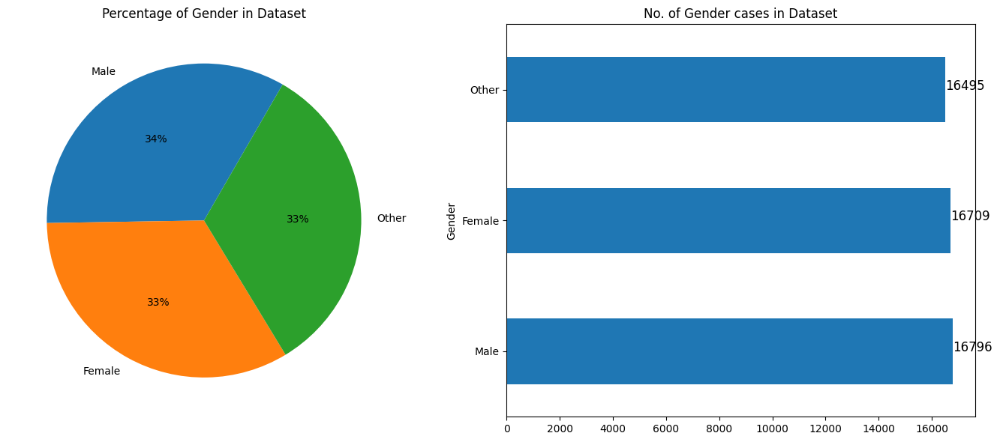

In [28]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

# PIE CHART
df_value_counts = df['Gender'].value_counts()
ax1 = df_value_counts.plot.pie(
    autopct="%1.0f%%", 
    startangle=60, 
    ax=ax1
)
ax1.set_ylabel('')  # Remove default y-label
ax1.set_title('Percentage of Gender in Dataset')

# BARH CHART
ax2 = df_value_counts.plot(kind="barh", ax=ax2)
for i, (index, value) in enumerate(df_value_counts.items()):
    ax2.text(value + 0.5, i, str(value), fontsize=12)
ax2.set_title('No. of Gender cases in Dataset')

plt.tight_layout()
plt.show()


In [29]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,Male,UK,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,Male,China,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,Male,Pakistan,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,Male,UK,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,Female,Brazil,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


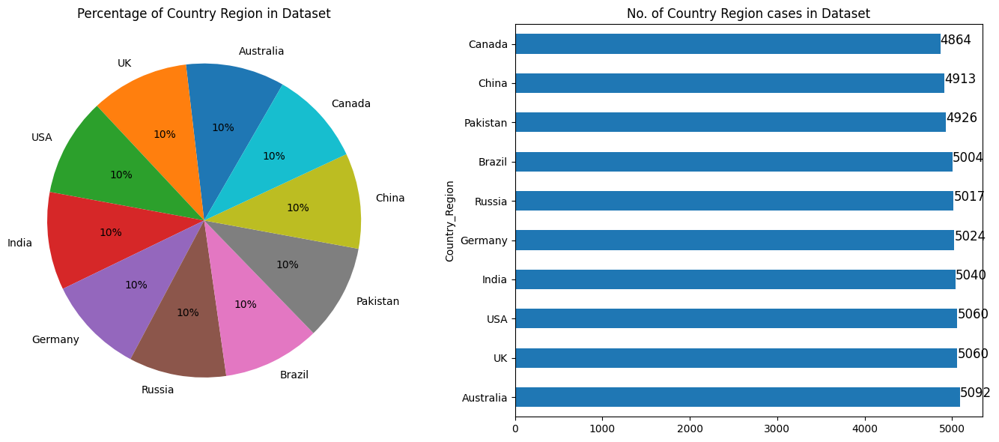

In [30]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

# PIE CHART
df_value_counts = df['Country_Region'].value_counts()
ax1 = df_value_counts.plot.pie(
    autopct="%1.0f%%", 
    startangle=60, 
    ax=ax1
)
ax1.set_ylabel('')  # Remove default y-label
ax1.set_title('Percentage of Country Region in Dataset')

# BARH CHART
ax2 = df_value_counts.plot(kind="barh", ax=ax2)
for i, (index, value) in enumerate(df_value_counts.items()):
    ax2.text(value + 0.5, i, str(value), fontsize=12)
ax2.set_title('No. of Country Region cases in Dataset')

plt.tight_layout()
plt.show()


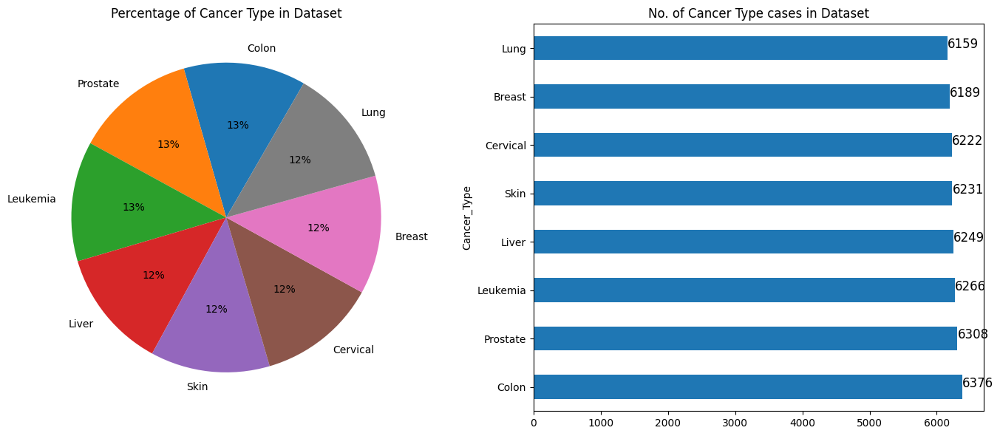

In [31]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

# PIE CHART
df_value_counts = df['Cancer_Type'].value_counts()
ax1 = df_value_counts.plot.pie(
    autopct="%1.0f%%", 
    startangle=60, 
    ax=ax1
)
ax1.set_ylabel('')  # Remove default y-label
ax1.set_title('Percentage of Cancer Type in Dataset')
# BARH CHART
ax2 = df_value_counts.plot(kind="barh", ax=ax2)
for i, (index, value) in enumerate(df_value_counts.items()):
    ax2.text(value + 0.5, i, str(value), fontsize=12)
ax2.set_title('No. of Cancer Type cases in Dataset')
plt.tight_layout()
plt.show()

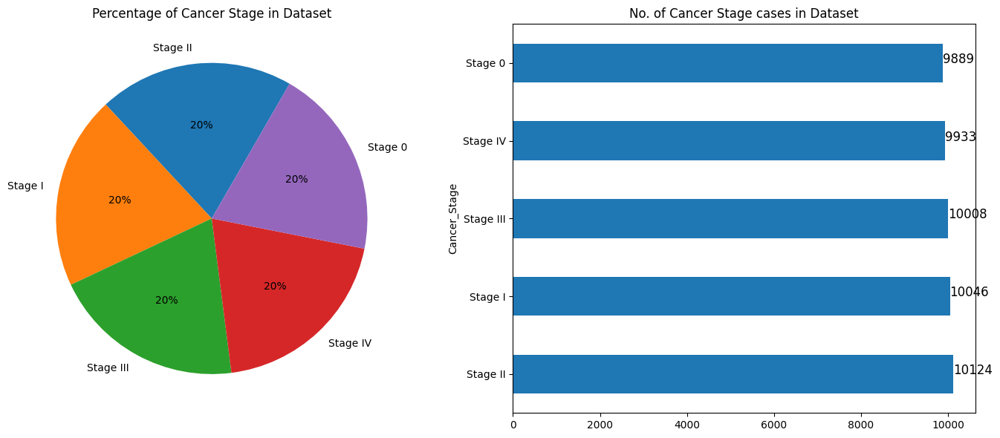

In [32]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

# PIE CHART
df_value_counts = df['Cancer_Stage'].value_counts()
ax1 = df_value_counts.plot.pie(
    autopct="%1.0f%%", 
    startangle=60, 
    ax=ax1
)
ax1.set_ylabel('')  # Remove default y-label
ax1.set_title('Percentage of Cancer Stage in Dataset')
# BARH CHART
ax2 = df_value_counts.plot(kind="barh", ax=ax2)
for i, (index, value) in enumerate(df_value_counts.items()):
    ax2.text(value + 0.5, i, str(value), fontsize=12)
ax2.set_title('No. of Cancer Stage cases in Dataset')
plt.tight_layout()
plt.show()

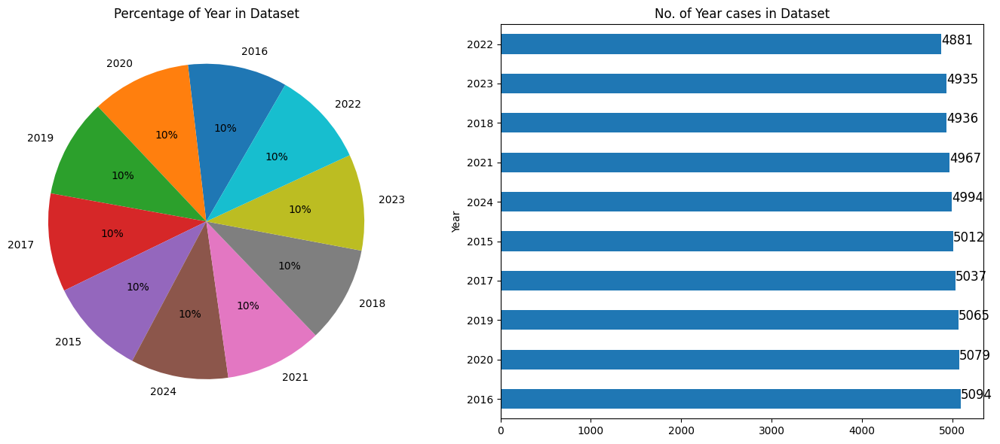

In [33]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

# PIE CHART
df_value_counts = df['Year'].value_counts()
ax1 = df_value_counts.plot.pie(
    autopct="%1.0f%%", 
    startangle=60, 
    ax=ax1
)
ax1.set_ylabel('')  # Remove default y-label
ax1.set_title('Percentage of Year in Dataset')
# BARH CHART
ax2 = df_value_counts.plot(kind="barh", ax=ax2)
for i, (index, value) in enumerate(df_value_counts.items()):
    ax2.text(value + 0.5, i, str(value), fontsize=12)
ax2.set_title('No. of Year cases in Dataset')
plt.tight_layout()
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\1140828848.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


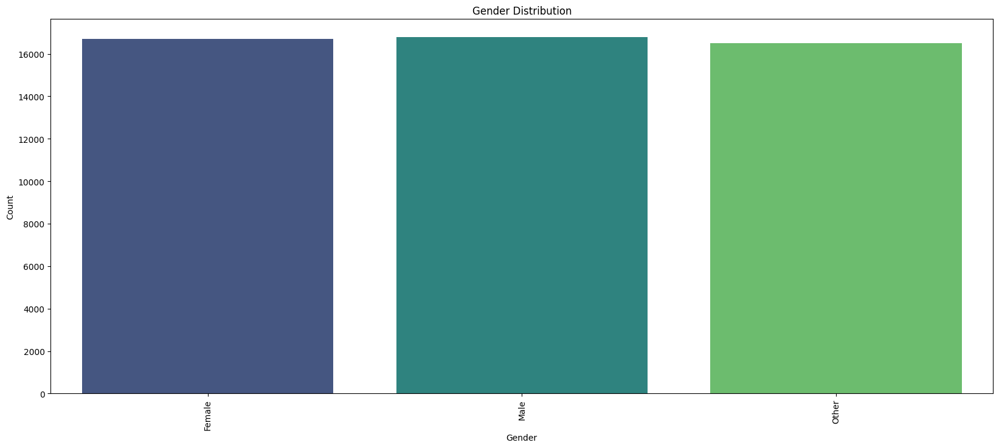

In [34]:
unique_ages = df['Gender'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Gender Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\2962320777.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


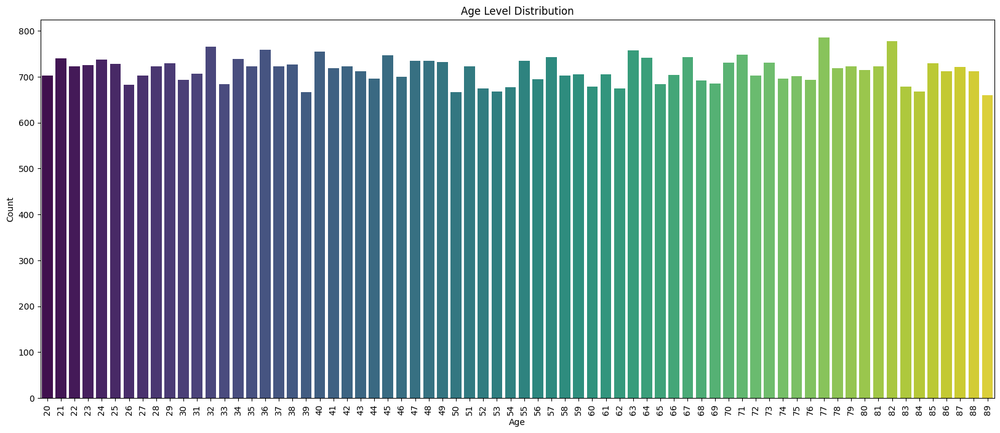

In [35]:
# Step 2: Age column theke unique values ber kora
unique_ages = df['Age'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Age Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\3726697.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


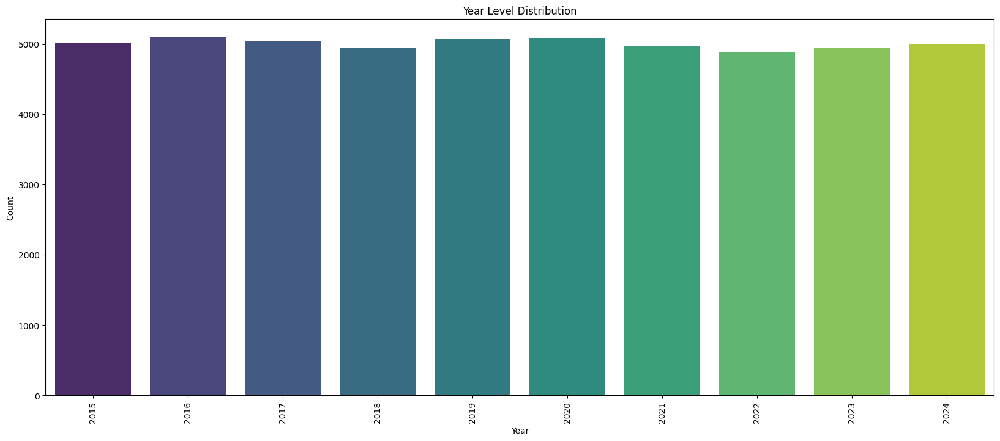

In [36]:
unique_ages = df['Year'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Year Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\1436150379.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


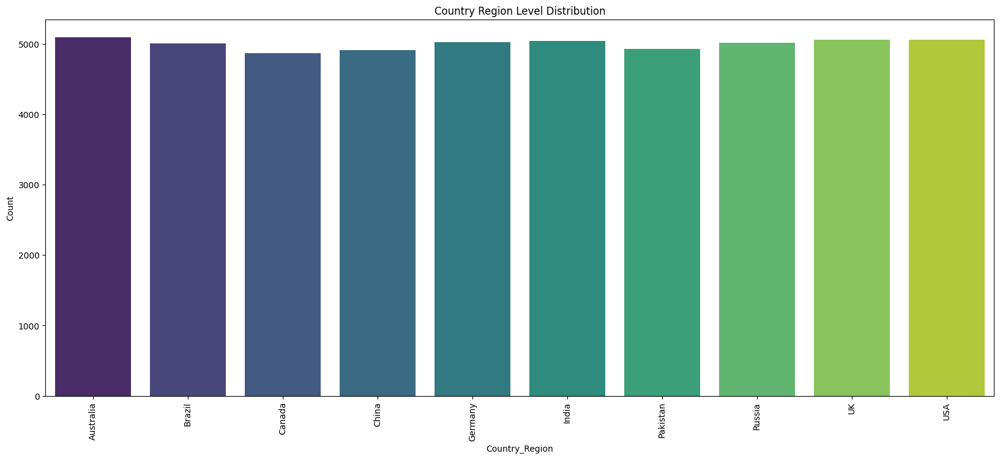

In [37]:
unique_ages = df['Country_Region'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Country_Region')
plt.ylabel('Count')
plt.title('Country Region Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\2927222003.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


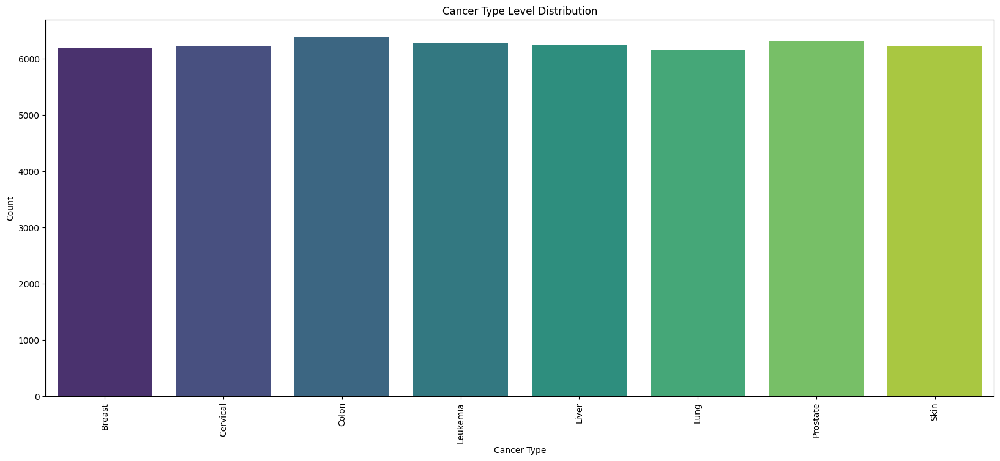

In [38]:
unique_ages = df['Cancer_Type'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Cancer Type')
plt.ylabel('Count')
plt.title('Cancer Type Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\3629045028.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


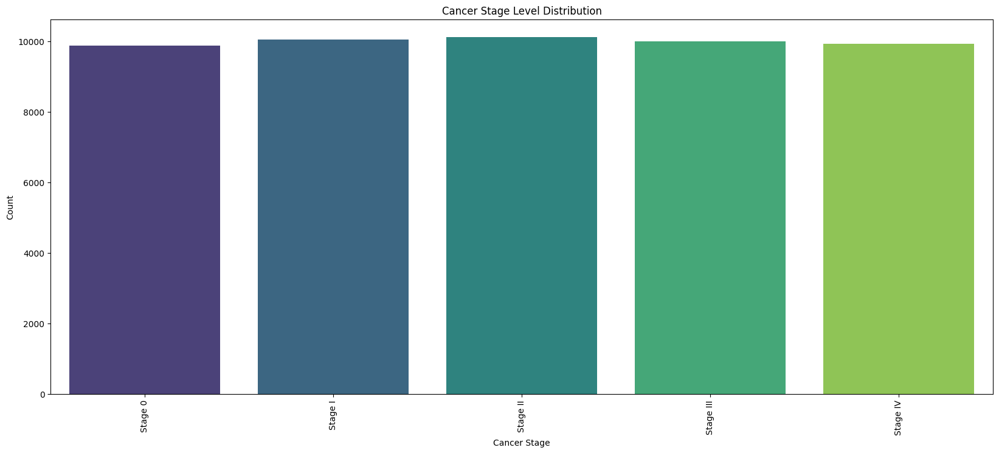

In [39]:
unique_ages = df['Cancer_Stage'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Cancer Stage')
plt.ylabel('Count')
plt.title('Cancer Stage Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\3014177553.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')


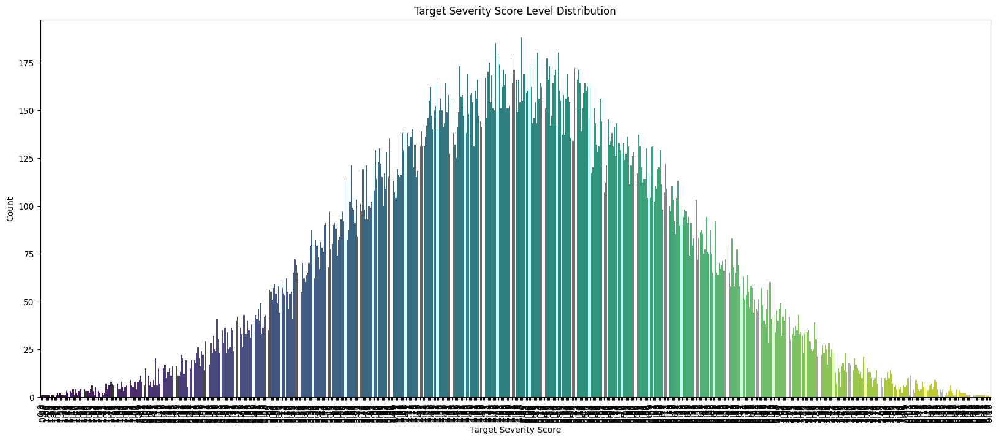

In [40]:
unique_ages = df['Target_Severity_Score'].value_counts().sort_index()

# Step 3: Bar plot create kora
plt.figure(figsize=(20, 8))
sns.barplot(x=unique_ages.index, y=unique_ages.values, palette='viridis')
plt.xlabel('Target Severity Score')
plt.ylabel('Count')
plt.title('Target Severity Score Level Distribution')
plt.xticks(rotation=90)  # Rotate x-axis labels if there are many unique ages
plt.show()

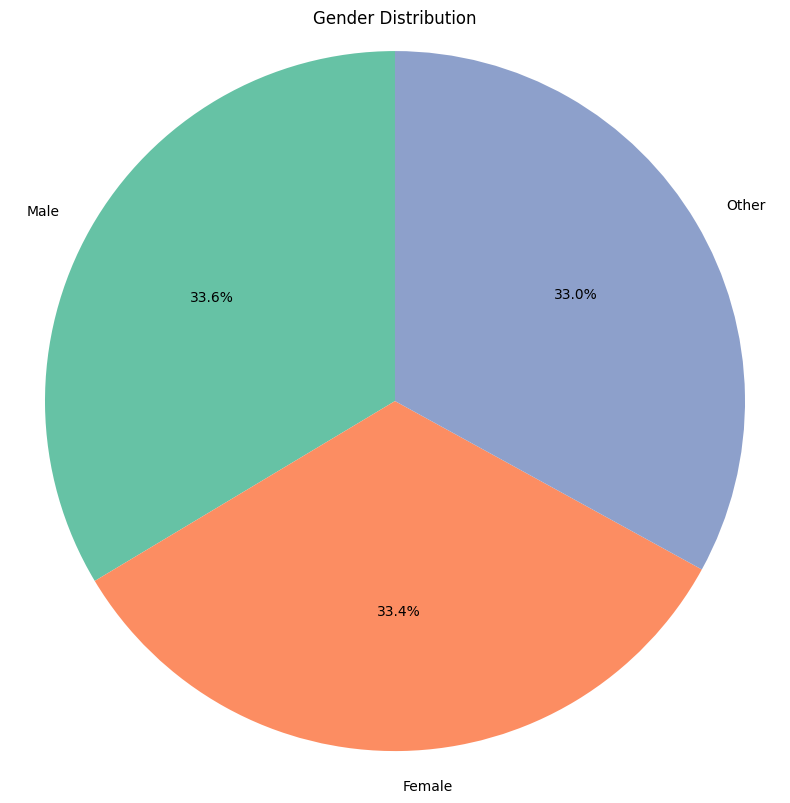

In [41]:
import matplotlib.pyplot as plt

# Get value counts
apc_counts = df['Gender'].value_counts()

# Plot pie chart
plt.figure(figsize=(8, 8))
plt.pie(apc_counts, labels=apc_counts.index, autopct='%1.1f%%', startangle=90, colors=['#66c2a5','#fc8d62','#8da0cb'])
plt.title('Gender Distribution')
plt.axis('equal')  # Equal aspect ratio ensures pie is circular
plt.tight_layout()
plt.show()


C:\Users\muham\AppData\Local\Temp\ipykernel_15096\3747277457.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=apc_counts.index, y=apc_counts.values, palette='viridis')


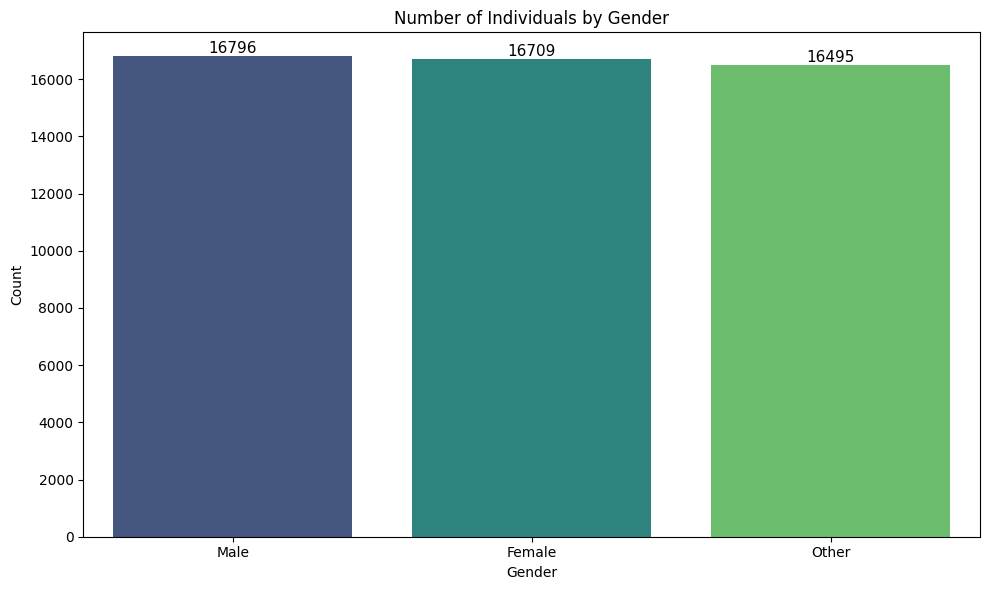

In [42]:
import seaborn as sns

# Plot bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x=apc_counts.index, y=apc_counts.values, palette='viridis')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Number of Individuals by Gender')

# Annotate each bar
for i, v in enumerate(apc_counts.values):
    plt.text(i, v + 5, str(v), ha='center', va='bottom', fontsize=11)

plt.tight_layout()
plt.show()


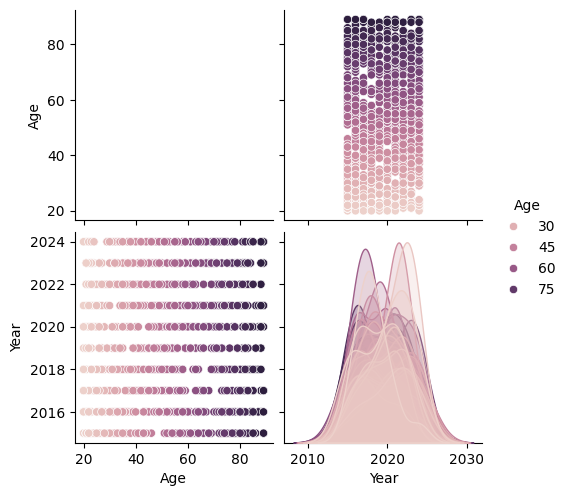

In [43]:
import seaborn as sns

# Ensure dataset has enough rows
sample_size = min(1000, len(df))  # Take the minimum of 1000 or the number of rows available

# Select specific columns
columns_to_include = ['Age', 'Year']

# Plot
sns.pairplot(df.sample(n=sample_size), vars=columns_to_include, hue="Age")


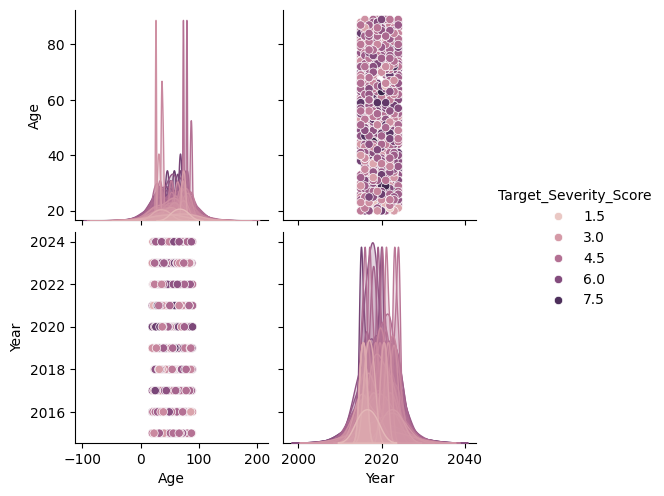

In [44]:
import seaborn as sns

# Ensure dataset has enough rows
sample_size = min(1000, len(df))  # Take the minimum of 1000 or the number of rows available

# Select specific columns
columns_to_include = ['Age', 'Year']

# Plot
sns.pairplot(df.sample(n=sample_size), vars=columns_to_include, hue="Target_Severity_Score")


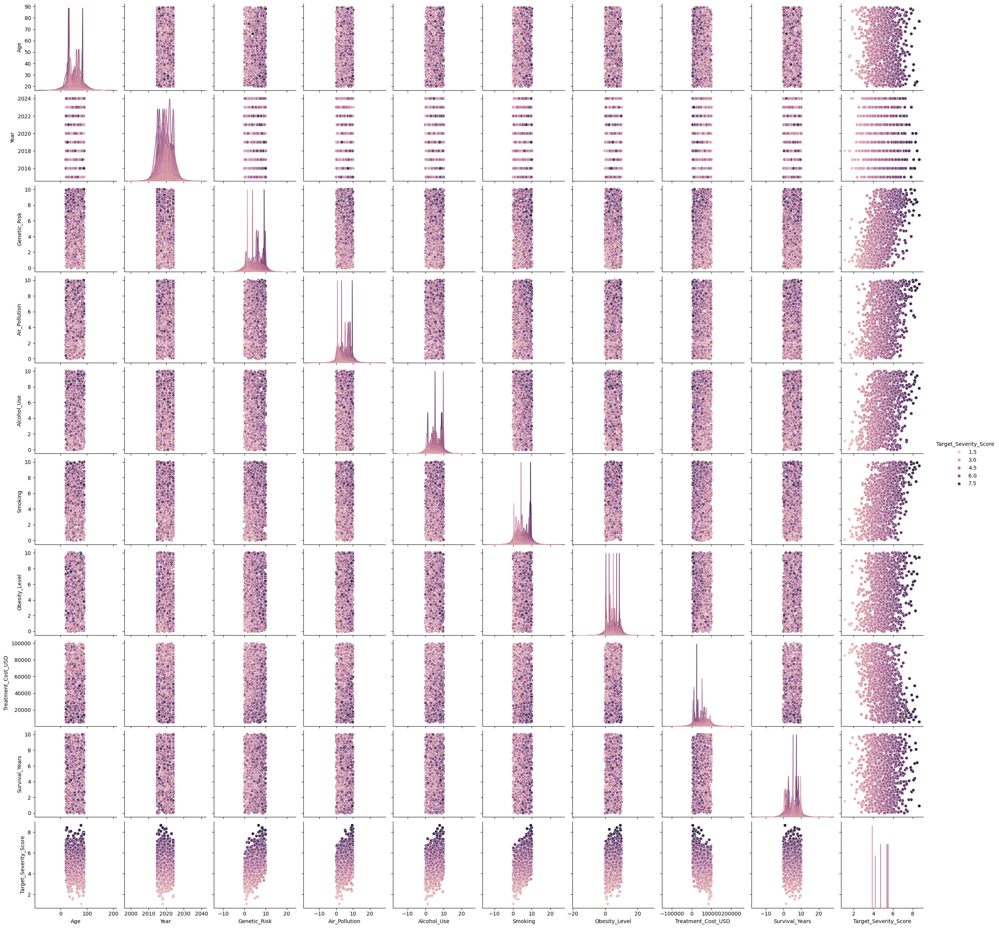

In [45]:
import seaborn as sns

# Ensure dataset has enough rows
sample_size = min(1000, len(df))  # Take the minimum of 1000 or the number of rows available

# Select specific columns
columns_to_include = ['Age', 'Year','Genetic_Risk',
       'Air_Pollution', 'Alcohol_Use', 'Smoking', 'Obesity_Level',
        'Treatment_Cost_USD', 'Survival_Years',
       'Target_Severity_Score']

# Plot
sns.pairplot(df.sample(n=sample_size), vars=columns_to_include, hue="Target_Severity_Score")


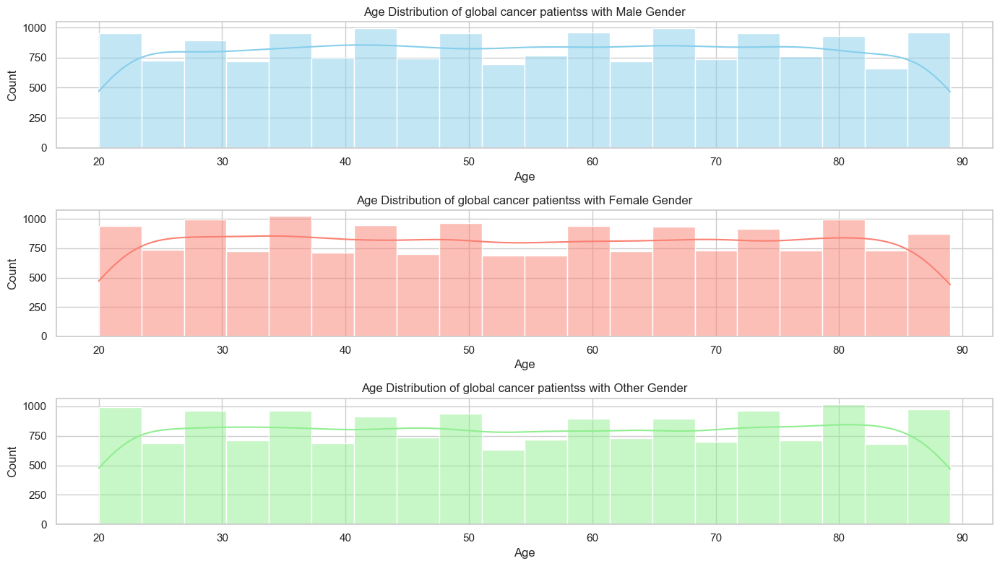

In [46]:
sns.set(style="whitegrid")

# Set up the figure
plt.figure(figsize=(14, 8))

# Filter the dataset for different Academic Performance Change categories
df_Male = df[df['Gender'] == 'Male']
df_Female= df[df['Gender'] == 'Female']
df_Other = df[df['Gender'] == 'Other']

# Age Distribution of global cancer patientss with 'Male' Academic Performance Change
plt.subplot(311)
sns.histplot(data=df_Male, x='Age', kde=True, color='skyblue', bins=20)
plt.title('Age Distribution of global cancer patientss with Male Gender')

# Age Distribution of global cancer patientss with 'Female' Academic Performance Change
plt.subplot(312)
sns.histplot(data=df_Female, x='Age', kde=True, color='salmon', bins=20)
plt.title('Age Distribution of global cancer patientss with Female Gender')

# Age Distribution of global cancer patientss with 'Other' Academic Performance Change
plt.subplot(313)
sns.histplot(data=df_Other, x='Age', kde=True, color='lightgreen', bins=20)
plt.title('Age Distribution of global cancer patientss with Other Gender')

plt.tight_layout()
plt.show()

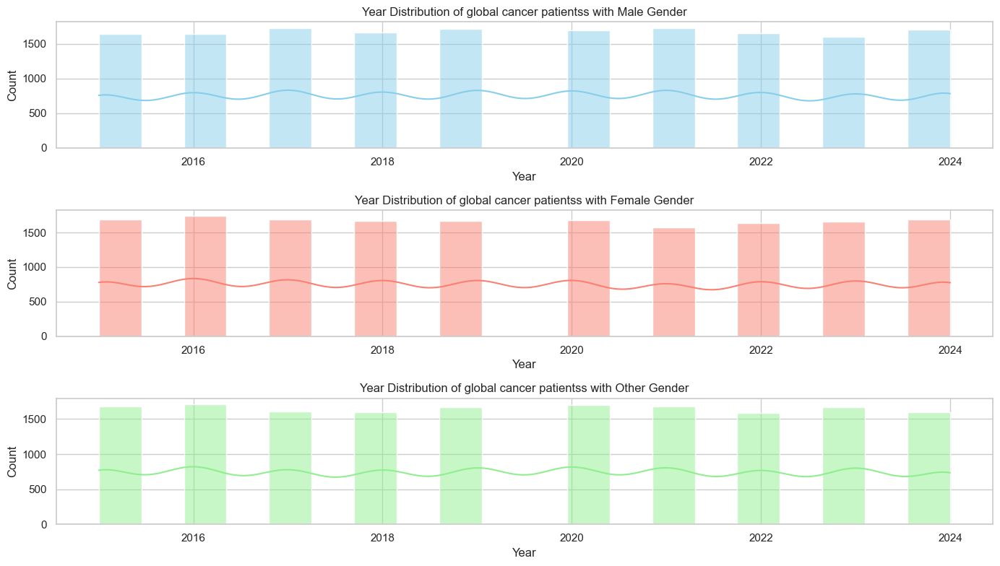

In [47]:
sns.set(style="whitegrid")

# Set up the figure
plt.figure(figsize=(14, 8))

# Filter the dataset for different Academic Performance Change categories
df_Male = df[df['Gender'] == 'Male']
df_Female = df[df['Gender'] == 'Female']
df_Other = df[df['Gender'] == 'Other']

# Year Distribution of global cancer patientss with 'Male' Academic Performance Change
plt.subplot(311)
sns.histplot(data=df_Male, x='Year', kde=True, color='skyblue', bins=20)
plt.title('Year Distribution of global cancer patientss with Male Gender')

# Year Distribution of global cancer patientss with 'Female' Academic Performance Change
plt.subplot(312)
sns.histplot(data=df_Female, x='Year', kde=True, color='salmon', bins=20)
plt.title('Year Distribution of global cancer patientss with Female Gender')

# Year Distribution of global cancer patientss with 'Other' Academic Performance Change
plt.subplot(313)
sns.histplot(data=df_Other, x='Year', kde=True, color='lightgreen', bins=20)
plt.title('Year Distribution of global cancer patientss with Other Gender')

plt.tight_layout()
plt.show()

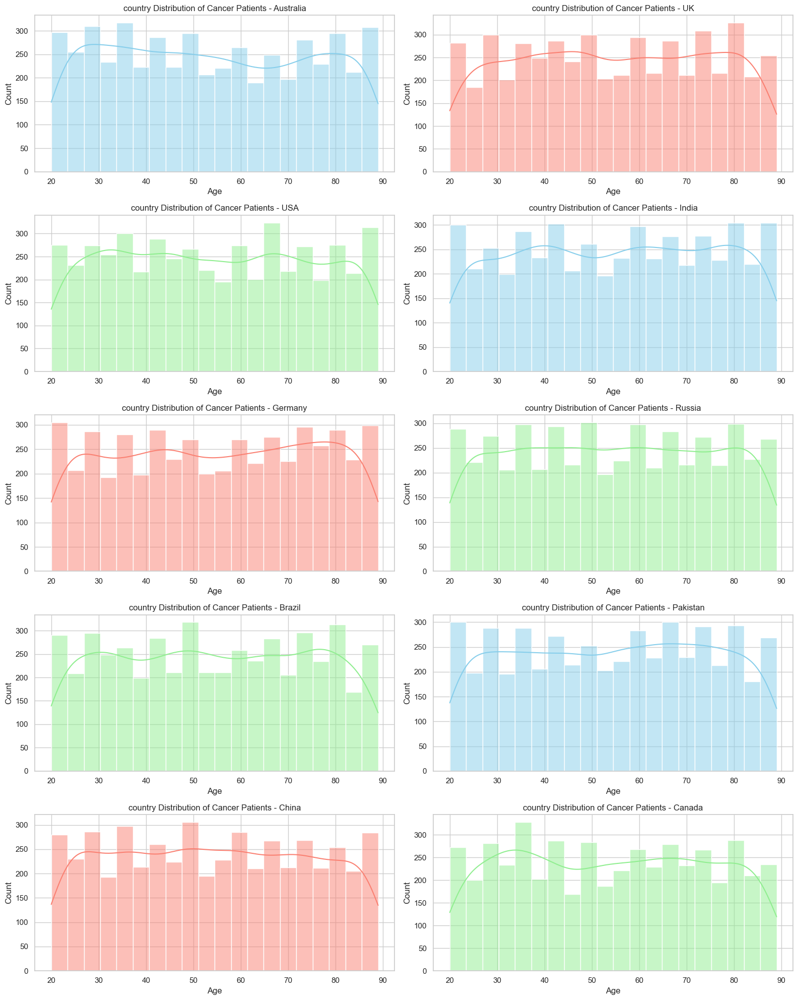

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style="whitegrid")

# Filter the dataset for different countries
countries = ['Australia', 'UK', 'USA', 'India', 'Germany', 'Russia', 'Brazil', 'Pakistan', 'China', 'Canada']
colors = ['skyblue', 'salmon', 'lightgreen', 'skyblue', 'salmon', 'lightgreen', 'lightgreen', 'skyblue', 'salmon', 'lightgreen']

# Set up the figure
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(16, 20))
axes = axes.flatten()

# Plot histograms
for i, (country, color) in enumerate(zip(countries, colors)):
    df_country = df[df['Country_Region'] == country]
    sns.histplot(data=df_country, x='Age', kde=True, color=color, bins=20, ax=axes[i])
    axes[i].set_title(f'country Distribution of Cancer Patients - {country}')

# Adjust layout
plt.tight_layout()
plt.show()


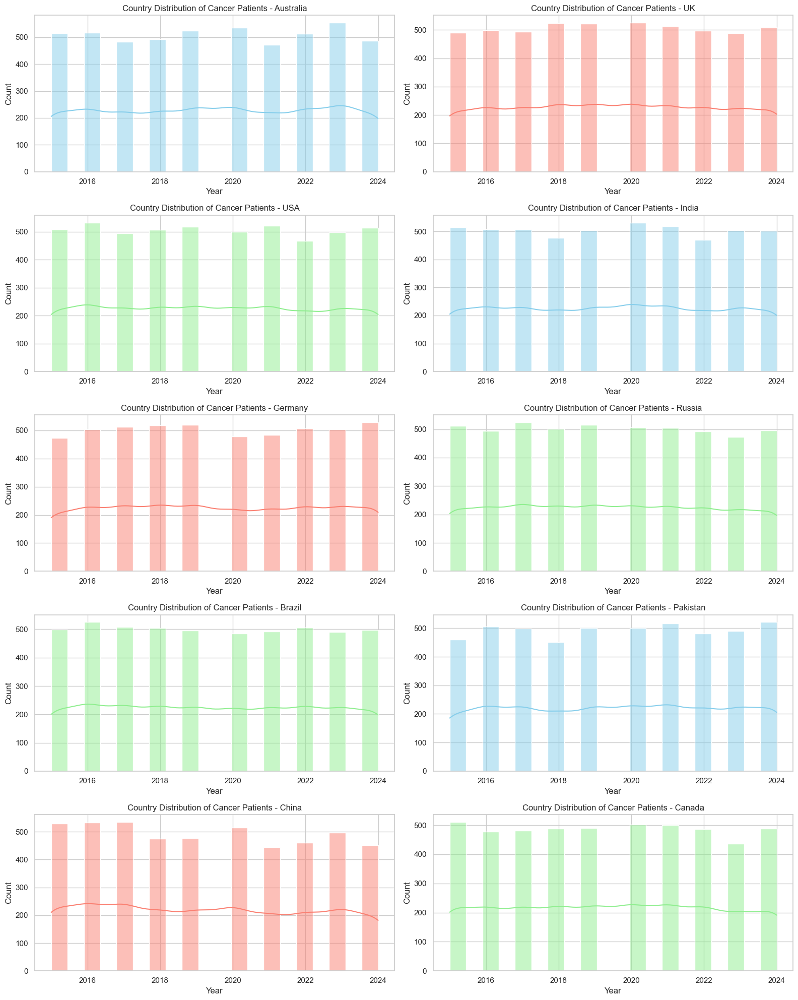

In [49]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style="whitegrid")

# Filter the dataset for different countries
countries = ['Australia', 'UK', 'USA', 'India', 'Germany', 'Russia', 'Brazil', 'Pakistan', 'China', 'Canada']
colors = ['skyblue', 'salmon', 'lightgreen', 'skyblue', 'salmon', 'lightgreen', 'lightgreen', 'skyblue', 'salmon', 'lightgreen']

# Set up the figure
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(16, 20))
axes = axes.flatten()

# Plot histograms
for i, (country, color) in enumerate(zip(countries, colors)):
    df_country = df[df['Country_Region'] == country]
    sns.histplot(data=df_country, x='Year', kde=True, color=color, bins=20, ax=axes[i])
    axes[i].set_title(f'Country Distribution of Cancer Patients - {country}')

# Adjust layout
plt.tight_layout()
plt.show()


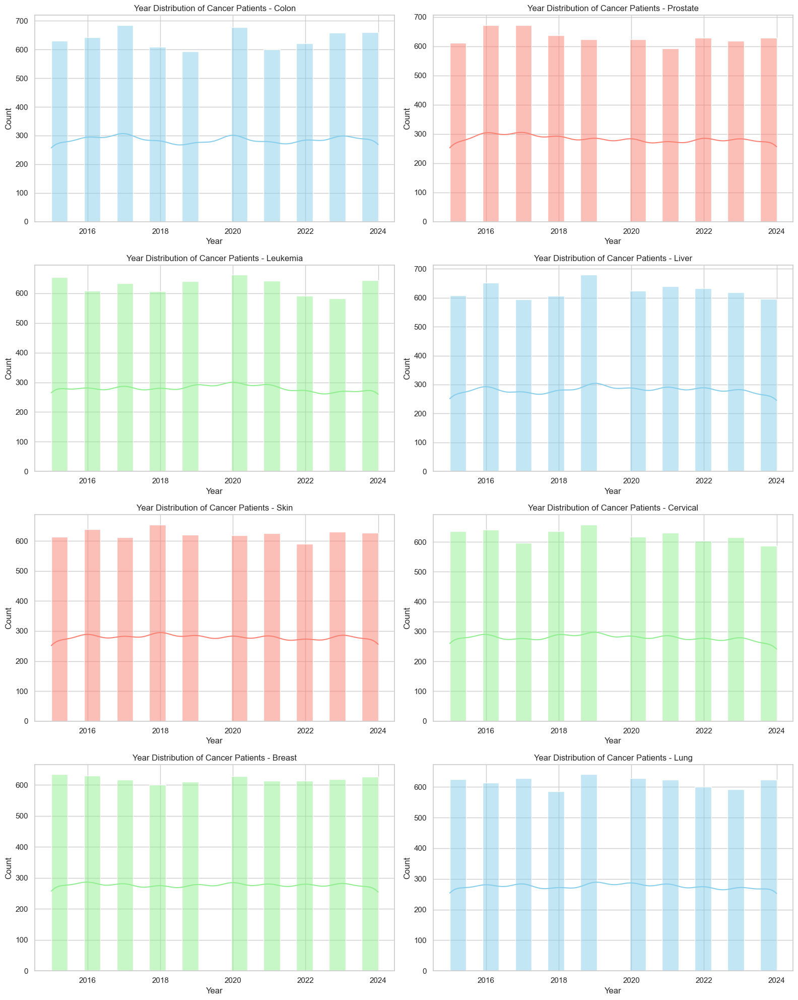

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style="whitegrid")

# Filter the dataset for different countries
countries = ['Colon', 'Prostate', 'Leukemia', 'Liver', 'Skin', 'Cervical', 'Breast', 'Lung']
colors = ['skyblue', 'salmon', 'lightgreen', 'skyblue', 'salmon', 'lightgreen', 'lightgreen', 'skyblue']

# Set up the figure
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(16, 20))
axes = axes.flatten()

# Plot histograms
for i, (country, color) in enumerate(zip(countries, colors)):
    df_country = df[df['Cancer_Type'] == country]
    sns.histplot(data=df_country, x='Year', kde=True, color=color, bins=20, ax=axes[i])
    axes[i].set_title(f'Year Distribution of Cancer Patients - {country}')

# Adjust layout
plt.tight_layout()
plt.show()


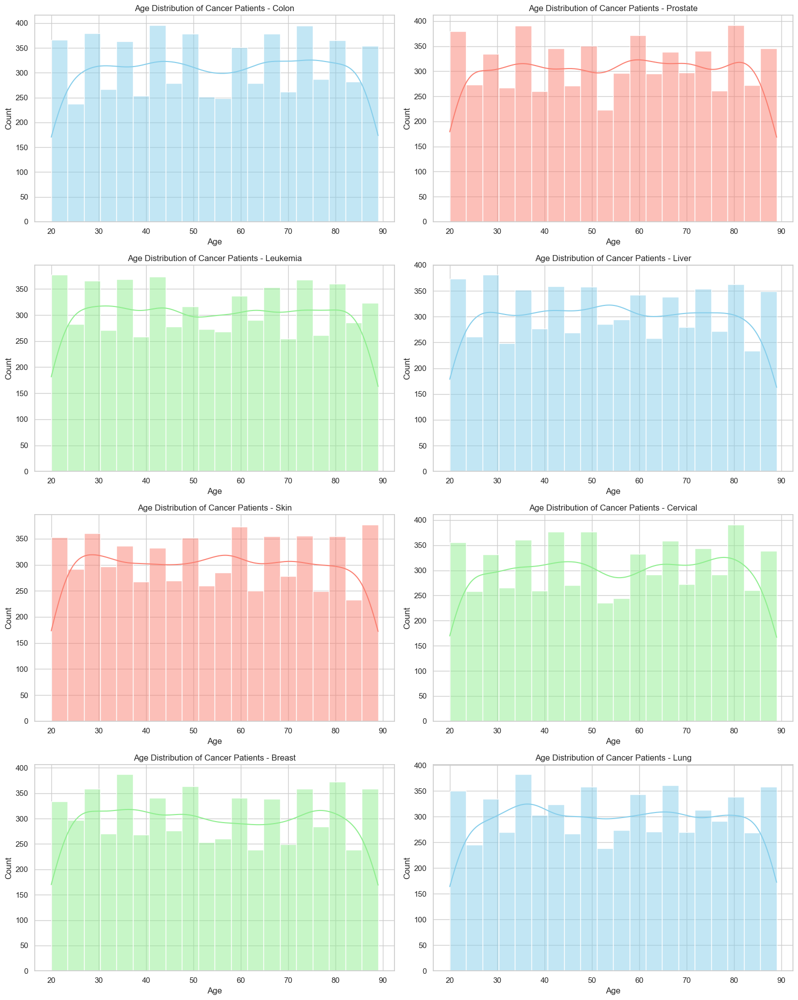

In [51]:
import matplotlib.pyplot as plta
import seaborn as sns

sns.set(style="whitegrid")

# Filter the dataset for different countries
countries = ['Colon', 'Prostate', 'Leukemia', 'Liver', 'Skin', 'Cervical', 'Breast', 'Lung']
colors = ['skyblue', 'salmon', 'lightgreen', 'skyblue', 'salmon', 'lightgreen', 'lightgreen', 'skyblue']

# Set up the figure
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(16, 20))
axes = axes.flatten()

# Plot histograms
for i, (country, color) in enumerate(zip(countries, colors)):
    df_country = df[df['Cancer_Type'] == country]
    sns.histplot(data=df_country, x='Age', kde=True, color=color, bins=20, ax=axes[i])
    axes[i].set_title(f'Age Distribution of Cancer Patients - {country}')

# Adjust layout
plt.tight_layout()
plt.show()


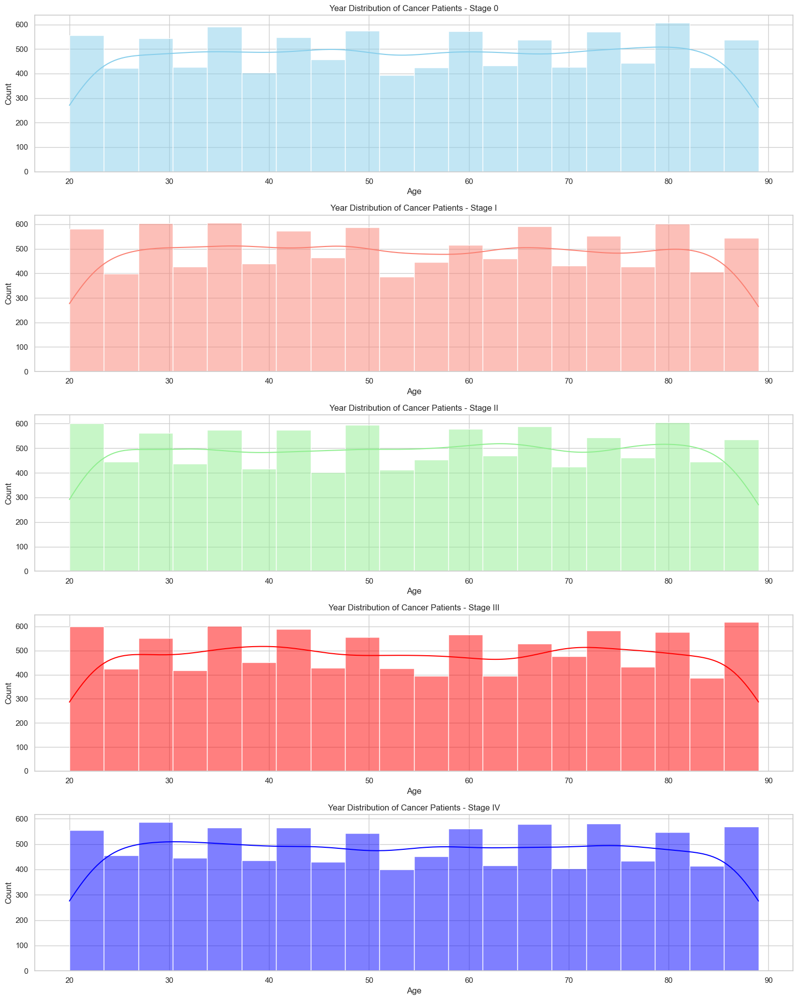

In [52]:
import matplotlib.pyplot as plta
import seaborn as sns

sns.set(style="whitegrid")

# Filter the dataset for different countries
countries = ['Stage 0', 'Stage I', 'Stage II', 'Stage III', 'Stage IV']
colors = ['skyblue', 'salmon', 'lightgreen', 'red', 'blue']

# Set up the figure
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(16, 20))
axes = axes.flatten()

# Plot histograms
for i, (country, color) in enumerate(zip(countries, colors)):
    df_country = df[df['Cancer_Stage'] == country]
    sns.histplot(data=df_country, x='Age', kde=True, color=color, bins=20, ax=axes[i])
    axes[i].set_title(f'Year Distribution of Cancer Patients - {country}')

# Adjust layout
plt.tight_layout()
plt.show()


In [53]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,Male,UK,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,Male,China,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,Male,Pakistan,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,Male,UK,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,Female,Brazil,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


<Axes: xlabel='Gender', ylabel='count'>

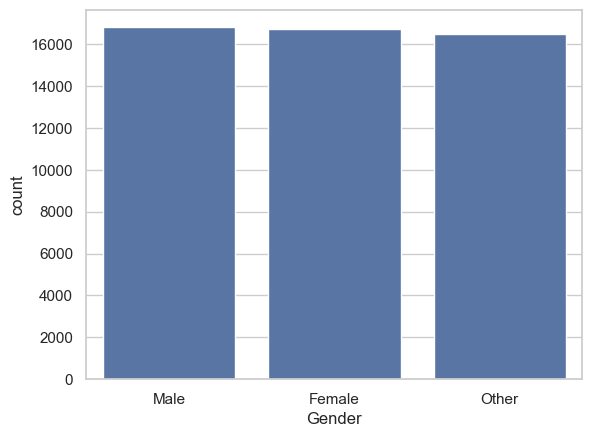

In [54]:
sns.countplot(x='Gender', data=df)

<Axes: xlabel='Country_Region', ylabel='count'>

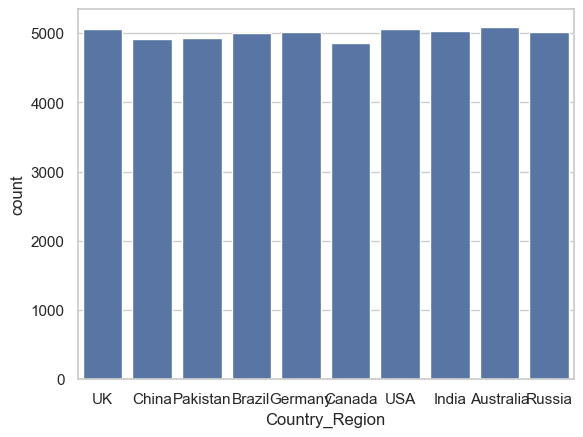

In [55]:
sns.countplot(x='Country_Region', data=df)

<Axes: xlabel='Cancer_Type', ylabel='count'>

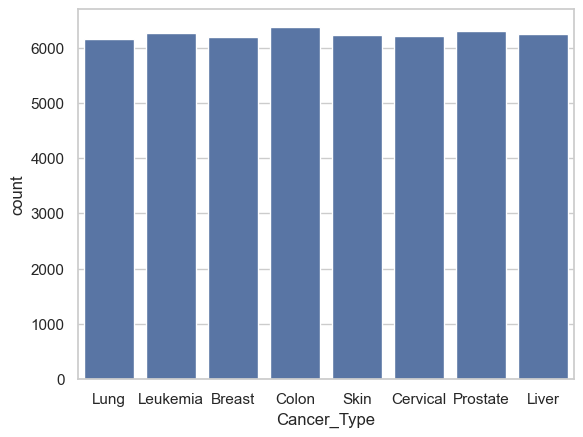

In [56]:
sns.countplot(x='Cancer_Type', data=df)

<Axes: xlabel='Cancer_Stage', ylabel='count'>

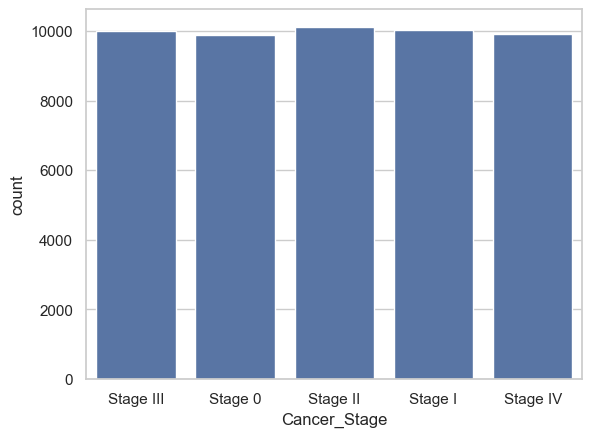

In [57]:
sns.countplot(x='Cancer_Stage', data=df)

<Axes: xlabel='Age', ylabel='count'>

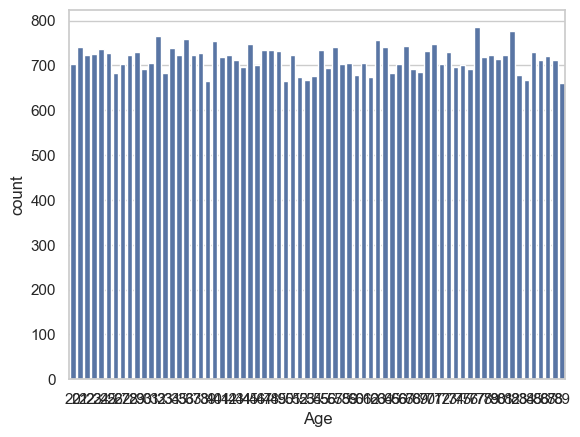

In [58]:
sns.countplot(x='Age', data=df)

<Axes: xlabel='Year', ylabel='count'>

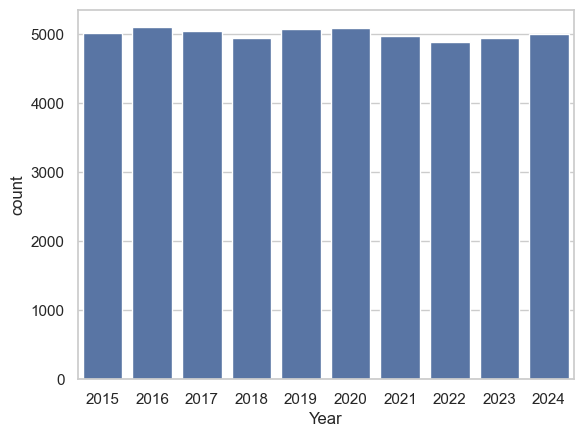

In [59]:
sns.countplot(x='Year', data=df)

<Axes: xlabel='Genetic_Risk', ylabel='count'>

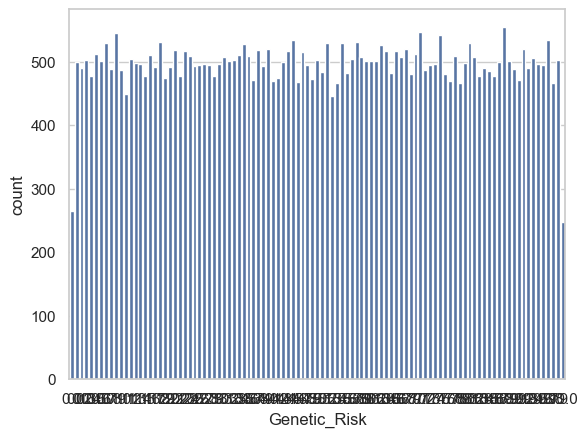

In [60]:
sns.countplot(x='Genetic_Risk', data=df)

<Axes: xlabel='Air_Pollution', ylabel='count'>

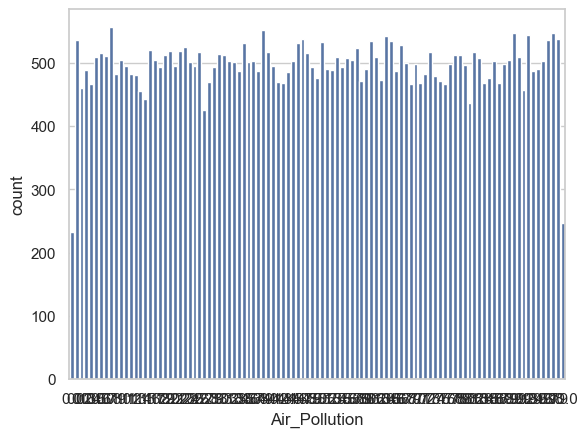

In [61]:
sns.countplot(x='Air_Pollution', data=df)

<Axes: xlabel='Alcohol_Use', ylabel='count'>

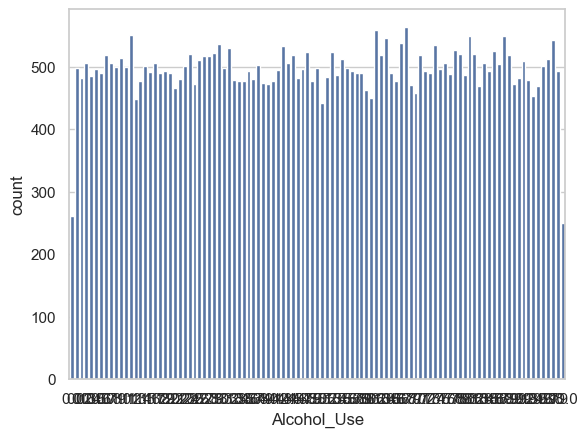

In [62]:
sns.countplot(x='Alcohol_Use', data=df)

<Axes: xlabel='Smoking', ylabel='count'>

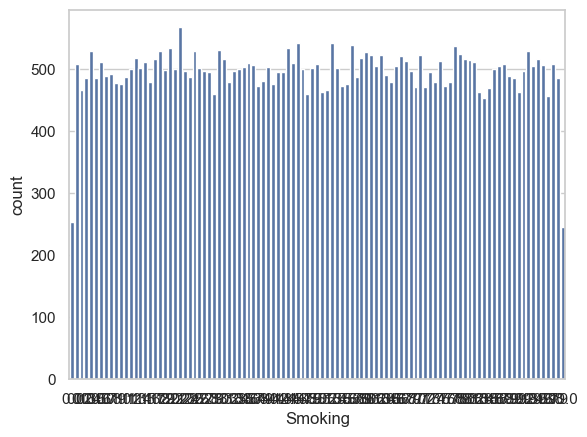

In [63]:
sns.countplot(x='Smoking', data=df)

<Axes: xlabel='Obesity_Level', ylabel='count'>

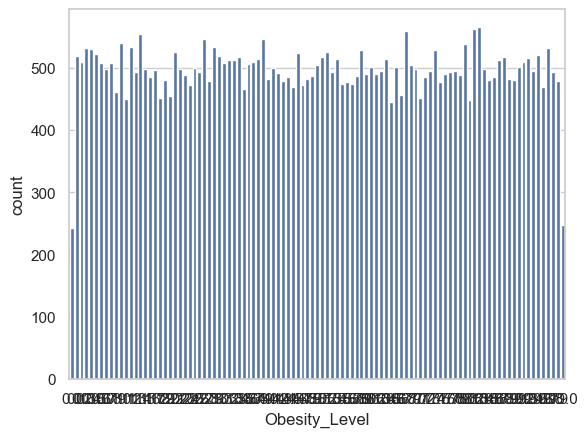

In [64]:
sns.countplot(x='Obesity_Level', data=df)

<Axes: xlabel='Survival_Years', ylabel='count'>

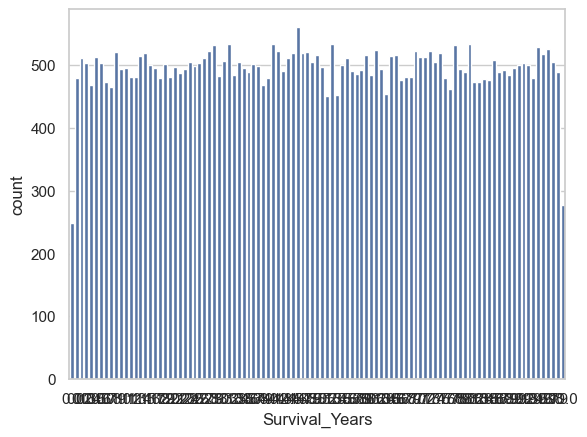

In [65]:
sns.countplot(x='Survival_Years', data=df)

<Axes: xlabel='Target_Severity_Score', ylabel='count'>

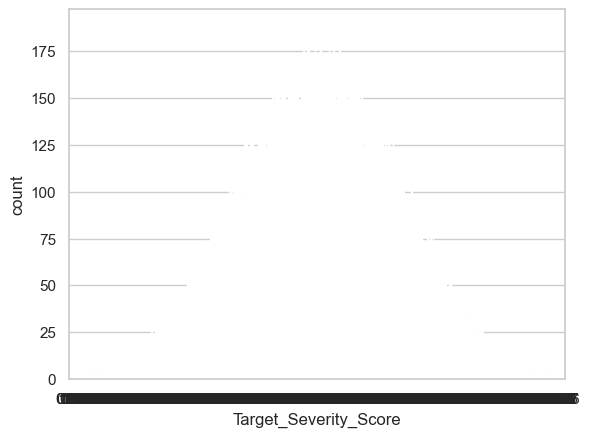

In [66]:
sns.countplot(x='Target_Severity_Score', data=df)

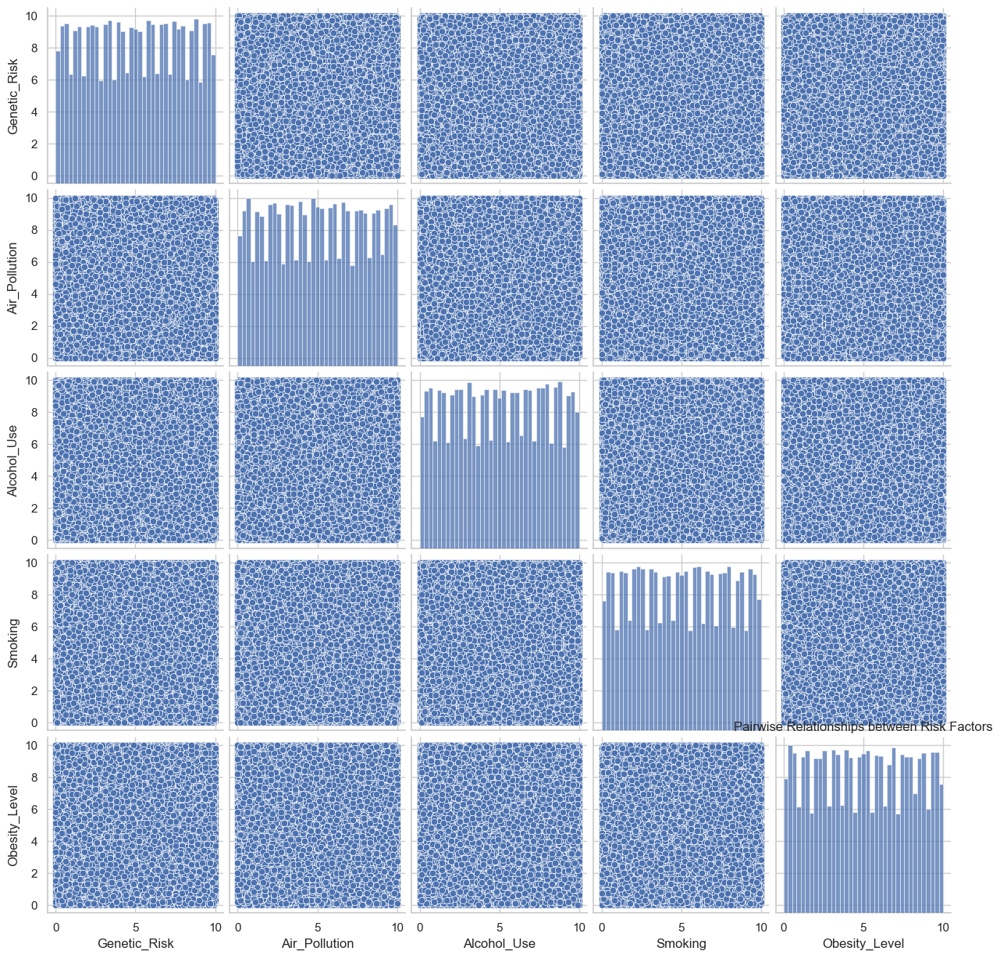

In [67]:
# Pairplot to visualize relationships between genetic risk and other factors
sns.pairplot(df[['Genetic_Risk', 'Air_Pollution', 'Alcohol_Use', 'Smoking', 'Obesity_Level']])
plt.title('Pairwise Relationships between Risk Factors')
plt.show()

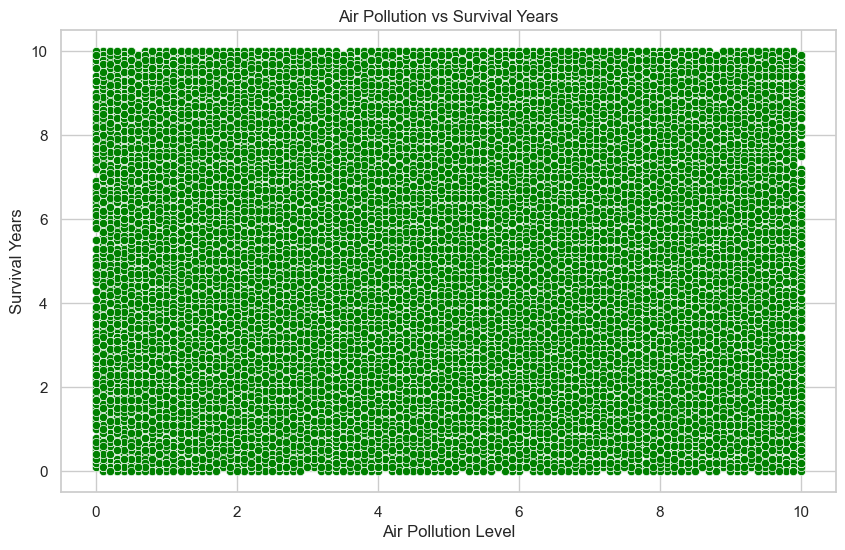

In [68]:
# Scatter plot for Air Pollution vs Survival Years
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Air_Pollution', y='Survival_Years', data=df, color='green')
plt.title('Air Pollution vs Survival Years')
plt.xlabel('Air Pollution Level')
plt.ylabel('Survival Years')
plt.show()

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\737885098.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Smoking', y='Survival_Years', data=df, palette='viridis')


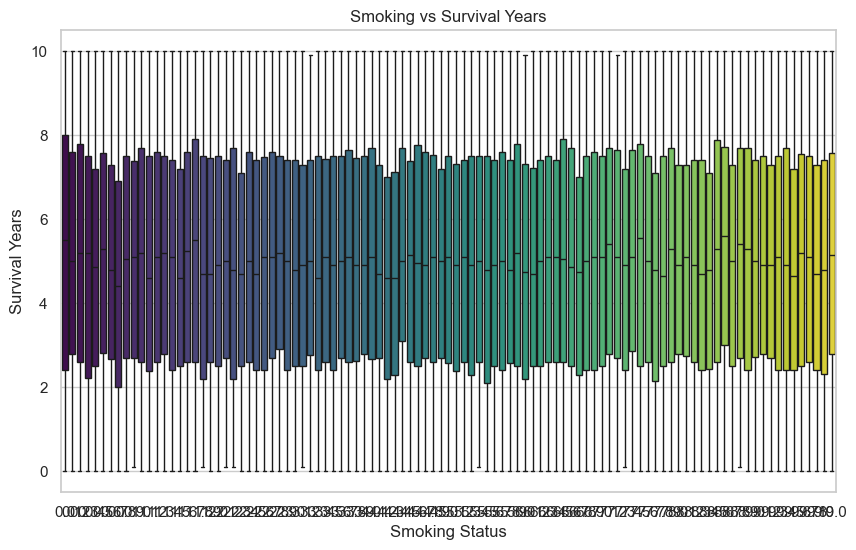

In [69]:
# Boxplot for Smoking vs Survival Years
plt.figure(figsize=(10, 6))
sns.boxplot(x='Smoking', y='Survival_Years', data=df, palette='viridis')
plt.title('Smoking vs Survival Years')
plt.xlabel('Smoking Status')
plt.ylabel('Survival Years')
plt.show()

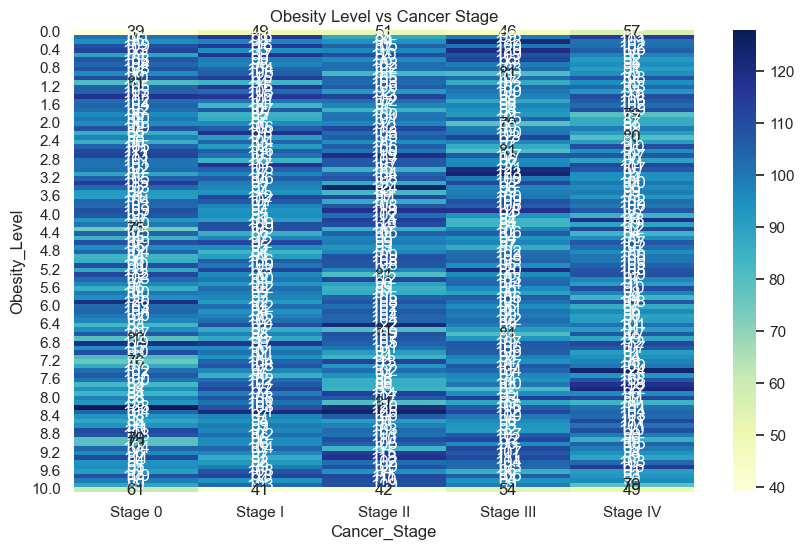

In [70]:
obesity_cancer_stage = df.groupby(['Obesity_Level', 'Cancer_Stage']).size().unstack()
plt.figure(figsize=(10, 6))
sns.heatmap(obesity_cancer_stage, annot=True, cmap='YlGnBu', fmt='d')
plt.title('Obesity Level vs Cancer Stage')
plt.show()

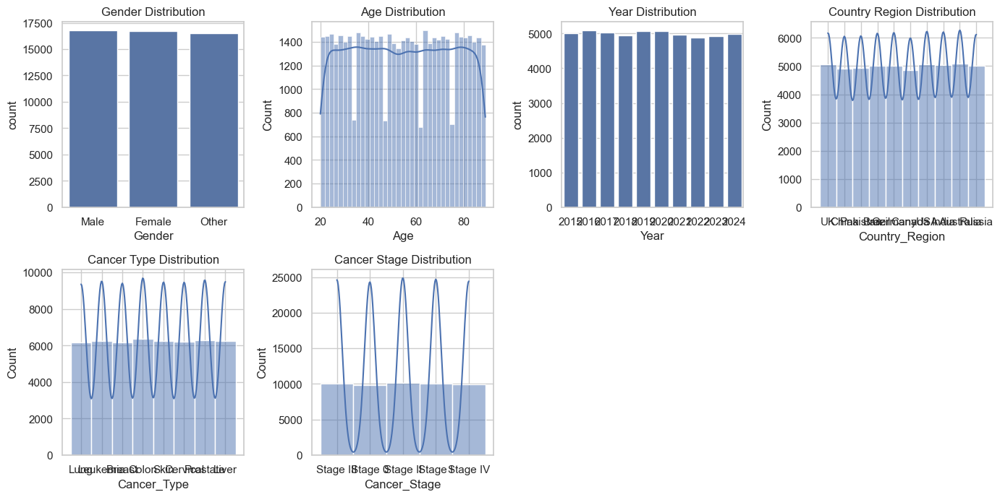

In [71]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Set the style for plots
sns.set(style="whitegrid")

# Set up the figure size for all plots
plt.figure(figsize=(14, 10))

# Plot for Gender
plt.subplot(3, 4, 1)
sns.countplot(x='Gender', data=df)
plt.title('Gender Distribution')

# Plot for Age
plt.subplot(3, 4, 2)
sns.histplot(df['Age'], kde=True)
plt.title('Age Distribution')

# Plot for year
plt.subplot(3, 4, 3)
sns.countplot(x='Year', data=df)
plt.title('Year Distribution')

# Plot for Country Region
plt.subplot(3, 4, 4)
sns.histplot(df['Country_Region'], kde=True)
plt.title('Country Region Distribution')

# Plot for Cancer Type
plt.subplot(3, 4, 5)
sns.histplot(df['Cancer_Type'], kde=True)
plt.title('Cancer Type Distribution')

# Plot for Cancer Stage
plt.subplot(3, 4, 6)
sns.histplot(df['Cancer_Stage'], kde=True)
plt.title('Cancer Stage Distribution')

plt.tight_layout()
plt.show()


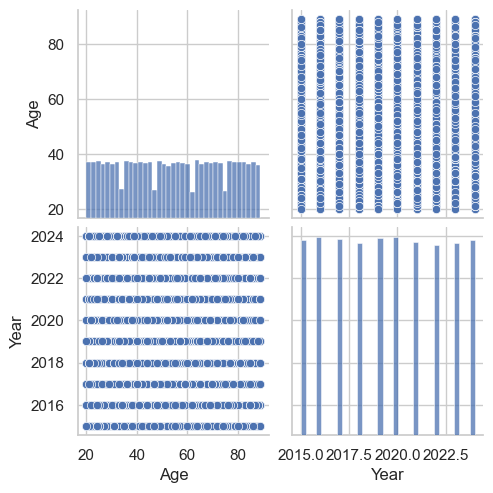

In [72]:
sns.pairplot(df[['Age', 'Year','Gender', 'Country_Region','Cancer_Type', 'Cancer_Stage',]])

<Axes: >

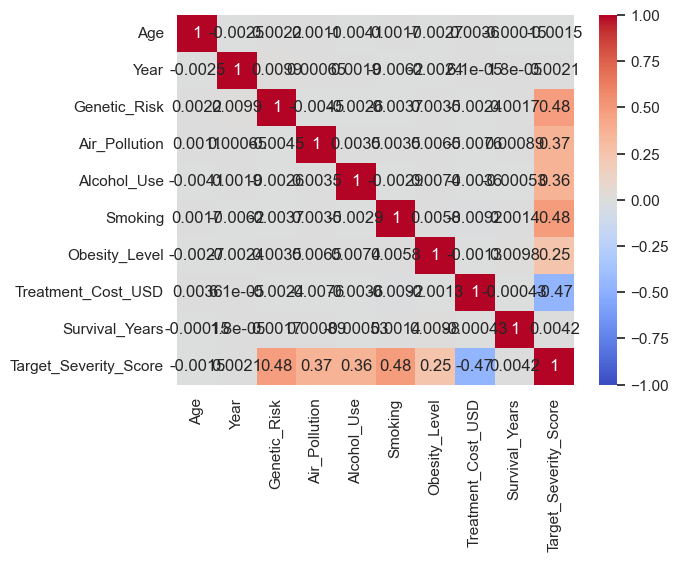

In [73]:
corr = df[['Age', 'Year','Genetic_Risk',
       'Air_Pollution', 'Alcohol_Use', 'Smoking', 'Obesity_Level',
        'Treatment_Cost_USD', 'Survival_Years',
       'Target_Severity_Score']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)

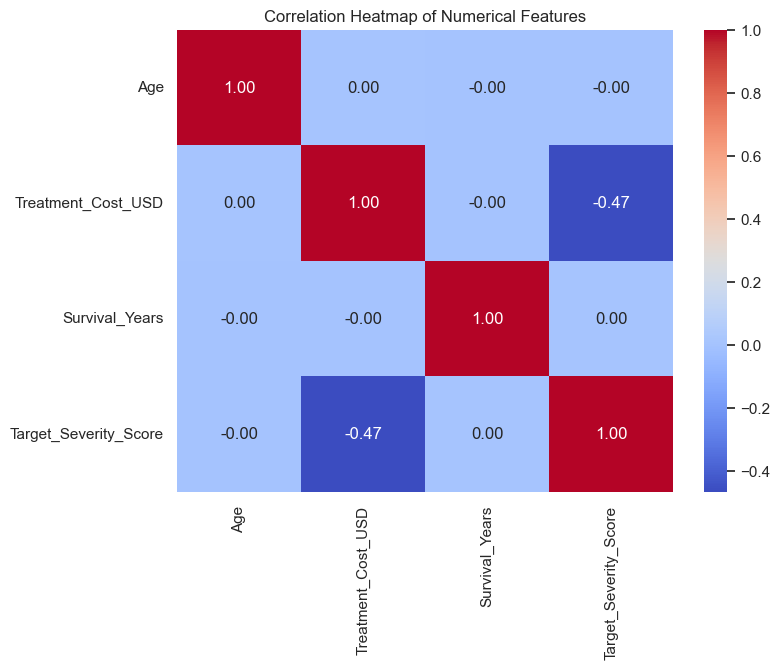

In [74]:
corr = df[['Age', 'Treatment_Cost_USD', 'Survival_Years', 'Target_Severity_Score']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap of Numerical Features')
plt.show()

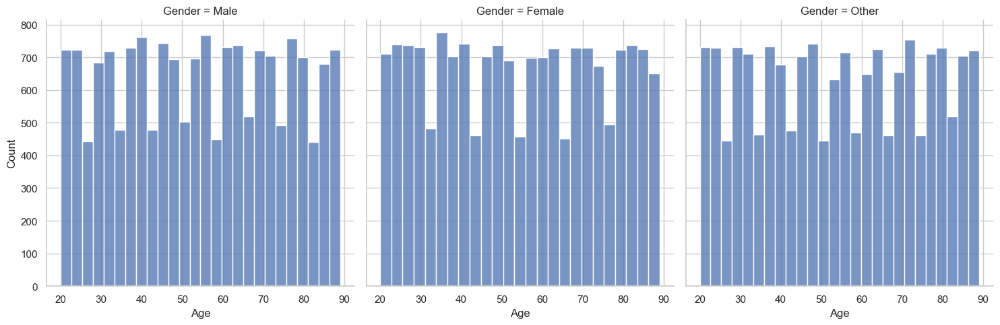

In [75]:
g = sns.FacetGrid(df, col='Gender', height=5)
g.map(sns.histplot, 'Age')

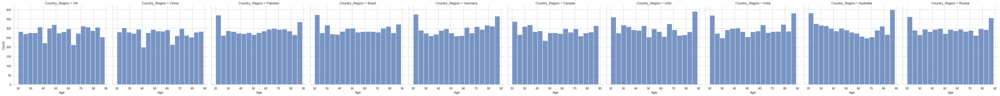

In [76]:
g = sns.FacetGrid(df, col='Country_Region', height=5)
g.map(sns.histplot, 'Age')

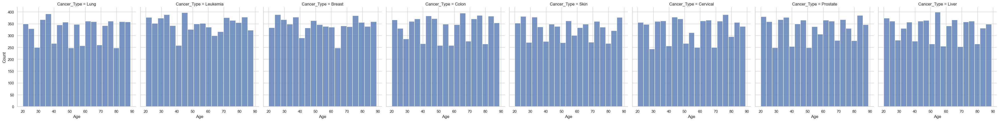

In [77]:
g = sns.FacetGrid(df, col='Cancer_Type', height=5)
g.map(sns.histplot, 'Age')

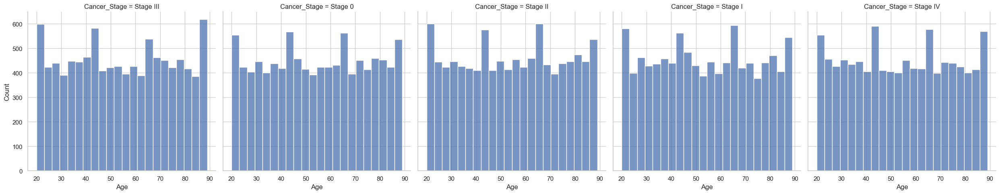

In [78]:
g = sns.FacetGrid(df, col='Cancer_Stage', height=5)
g.map(sns.histplot, 'Age')

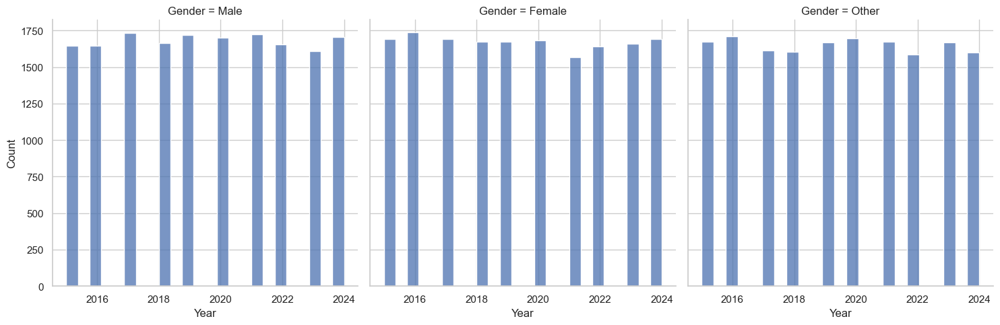

In [79]:
g = sns.FacetGrid(df, col='Gender', height=5)
g.map(sns.histplot, 'Year')

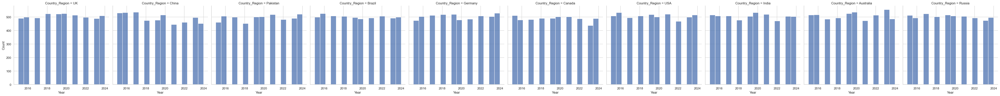

In [80]:
g = sns.FacetGrid(df, col='Country_Region', height=5)
g.map(sns.histplot, 'Year')

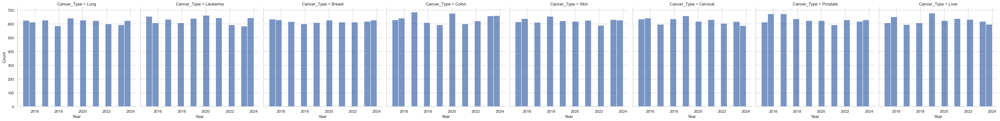

In [81]:
g = sns.FacetGrid(df, col='Cancer_Type', height=5)
g.map(sns.histplot, 'Year')

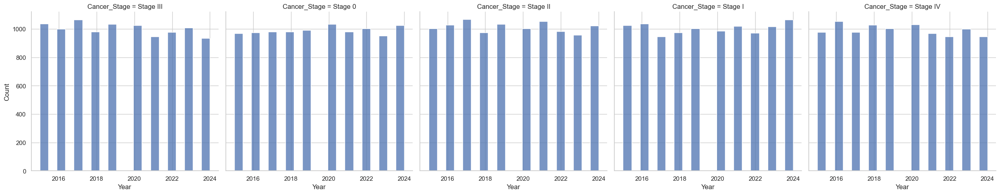

In [82]:
g = sns.FacetGrid(df, col='Cancer_Stage', height=5)
g.map(sns.histplot, 'Year')

C:\Users\muham\AppData\Local\Temp\ipykernel_15096\2893931499.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Cancer_Stage', y='Target_Severity_Score', data=df, palette='cubehelix')


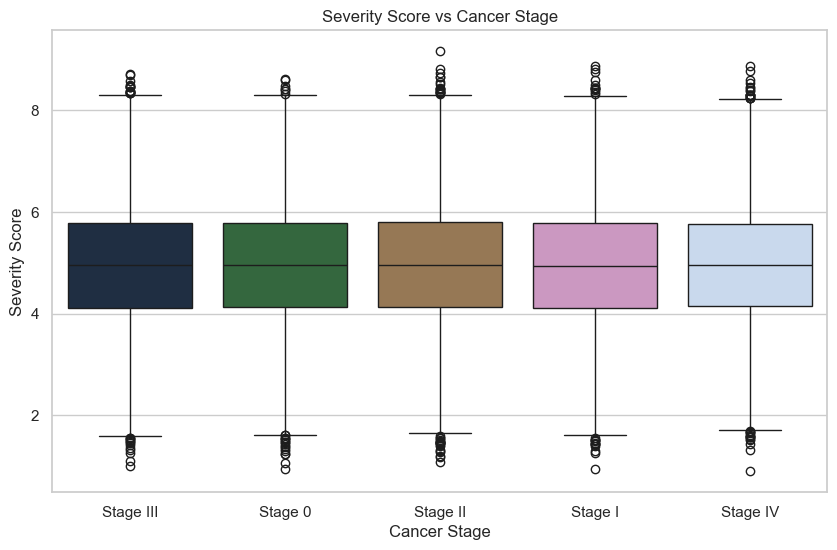

In [83]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Cancer_Stage', y='Target_Severity_Score', data=df, palette='cubehelix')
plt.title('Severity Score vs Cancer Stage')
plt.xlabel('Cancer Stage')
plt.ylabel('Severity Score')
plt.show()

<Axes: xlabel='Gender', ylabel='Age'>

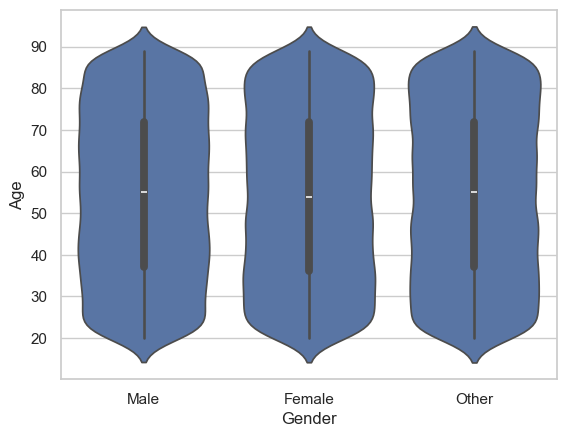

In [84]:
sns.violinplot(x='Gender', y='Age', data=df)

<Axes: xlabel='Country_Region', ylabel='Age'>

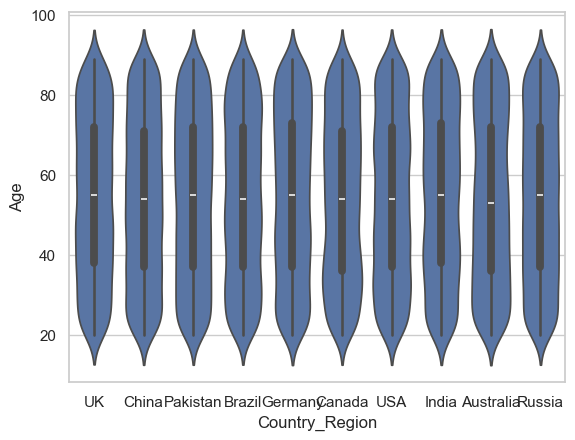

In [85]:
sns.violinplot(x='Country_Region', y='Age', data=df)

<Axes: xlabel='Cancer_Type', ylabel='Age'>

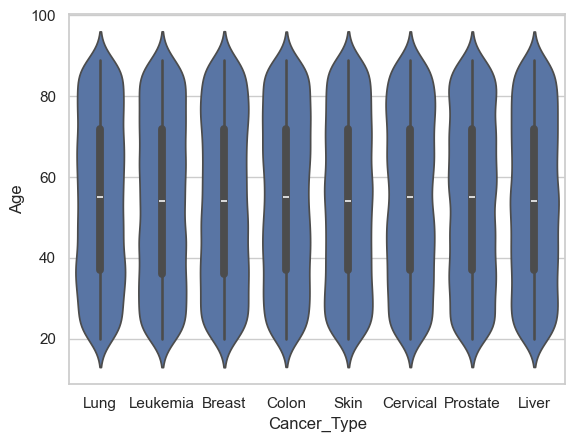

In [86]:
sns.violinplot(x='Cancer_Type', y='Age', data=df)

<Axes: xlabel='Cancer_Stage', ylabel='Age'>

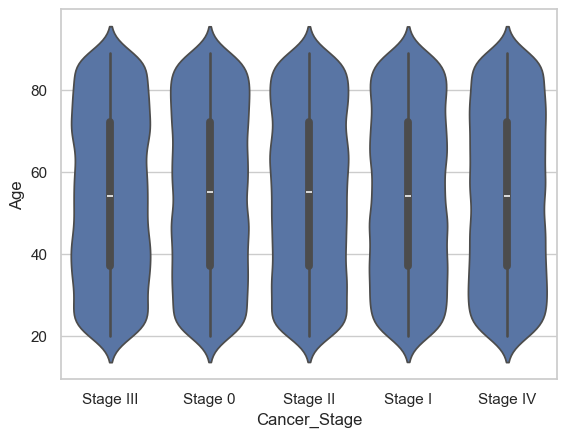

In [87]:
sns.violinplot(x='Cancer_Stage', y='Age', data=df)

<Axes: xlabel='Gender', ylabel='Age'>

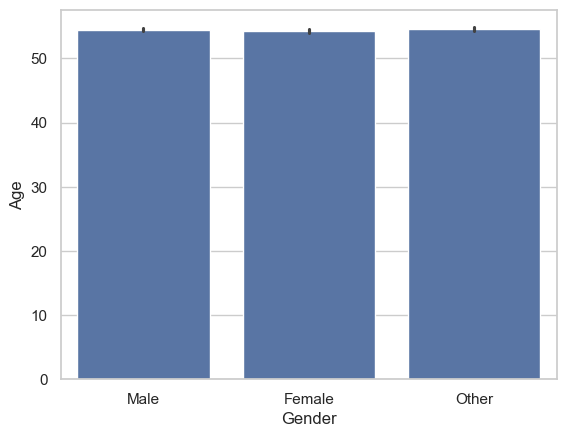

In [88]:
sns.barplot(x='Gender', y='Age', data=df)

<Axes: xlabel='Country_Region', ylabel='Age'>

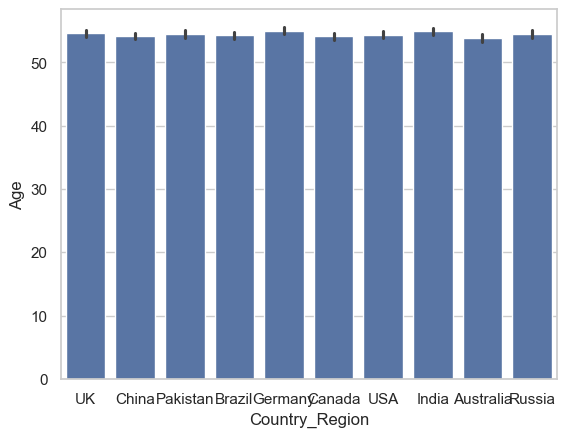

In [89]:
sns.barplot(x='Country_Region', y='Age', data=df)

<Axes: xlabel='Cancer_Type', ylabel='Age'>

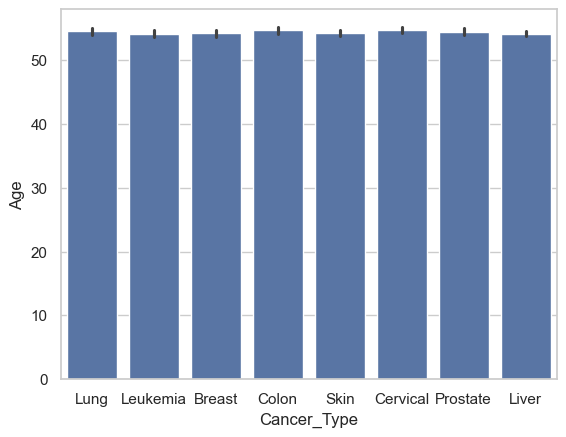

In [90]:
sns.barplot(x='Cancer_Type', y='Age', data=df)

<Axes: xlabel='Cancer_Stage', ylabel='Age'>

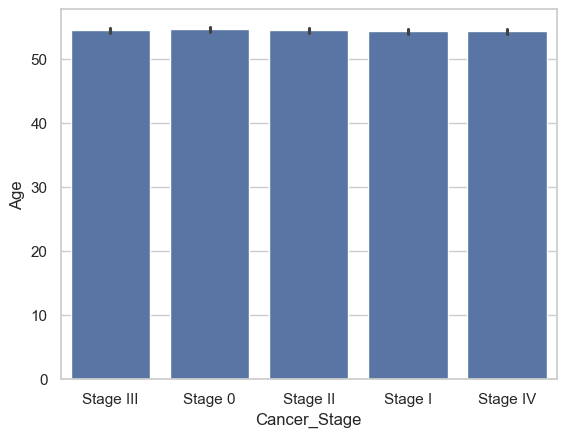

In [91]:
sns.barplot(x='Cancer_Stage', y='Age', data=df)

<Axes: xlabel='Gender', ylabel='Age'>

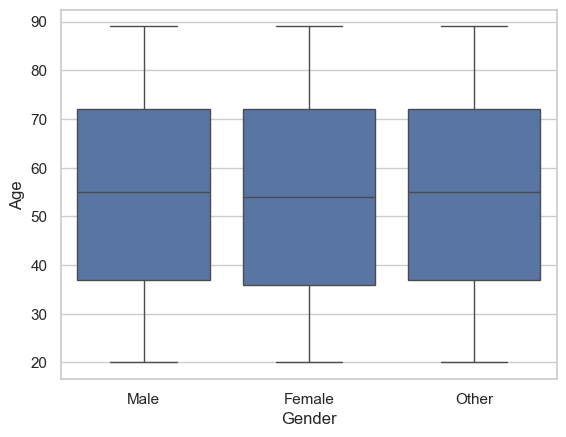

In [92]:
sns.boxplot(x='Gender', y='Age', data=df)

<Axes: xlabel='Country_Region', ylabel='Age'>

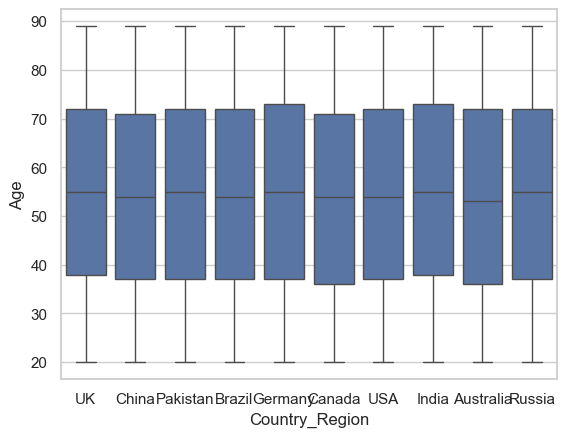

In [93]:
sns.boxplot(x='Country_Region', y='Age', data=df)

<Axes: xlabel='Cancer_Type', ylabel='Age'>

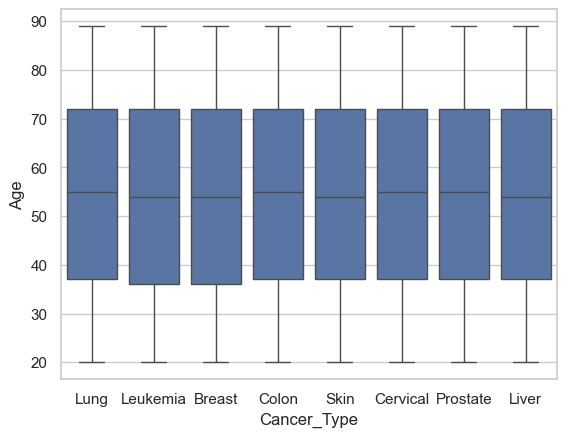

In [94]:
sns.boxplot(x='Cancer_Type', y='Age', data=df)

<Axes: xlabel='Cancer_Stage', ylabel='Age'>

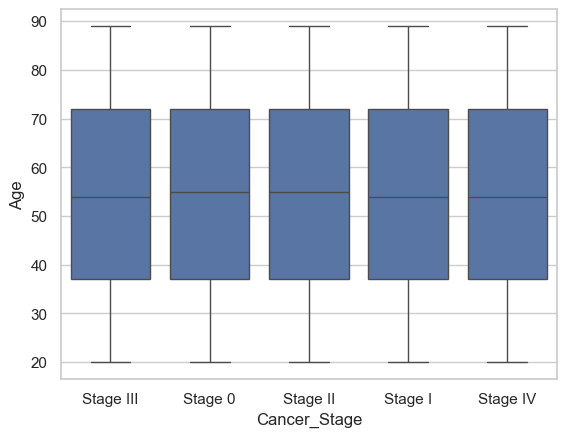

In [95]:
sns.boxplot(x='Cancer_Stage', y='Age', data=df)

<Axes: xlabel='Gender', ylabel='Year'>

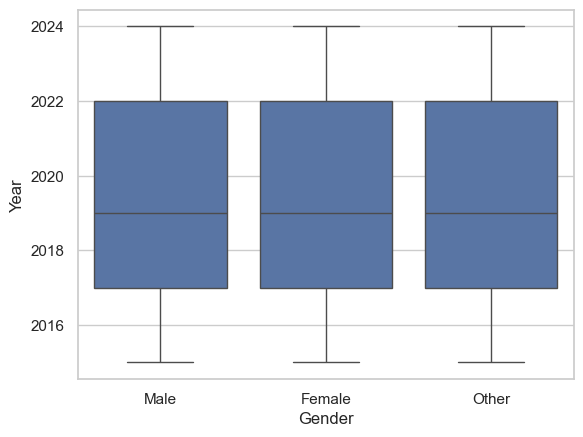

In [96]:
sns.boxplot(x='Gender', y='Year', data=df)

<Axes: xlabel='Country_Region', ylabel='Year'>

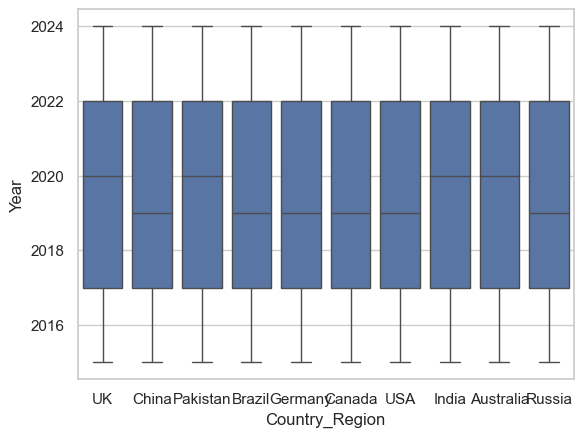

In [97]:
sns.boxplot(x='Country_Region', y='Year', data=df)

<Axes: xlabel='Cancer_Type', ylabel='Year'>

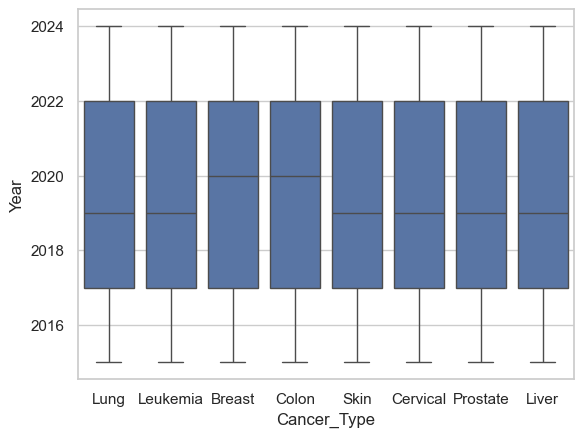

In [98]:
sns.boxplot(x='Cancer_Type', y='Year', data=df)

<Axes: xlabel='Cancer_Stage', ylabel='Year'>

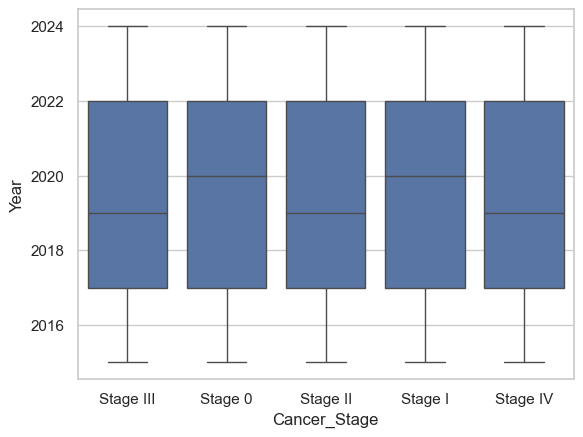

In [99]:
sns.boxplot(x='Cancer_Stage', y='Year', data=df)

<Axes: xlabel='Country_Region'>

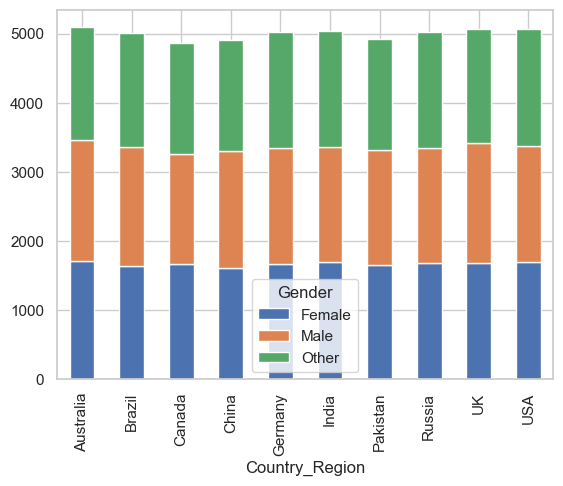

In [100]:
gender_counts = df.groupby(['Country_Region', 'Gender']).size().unstack()
gender_counts.plot(kind='bar', stacked=True)

<Axes: xlabel='Cancer_Type'>

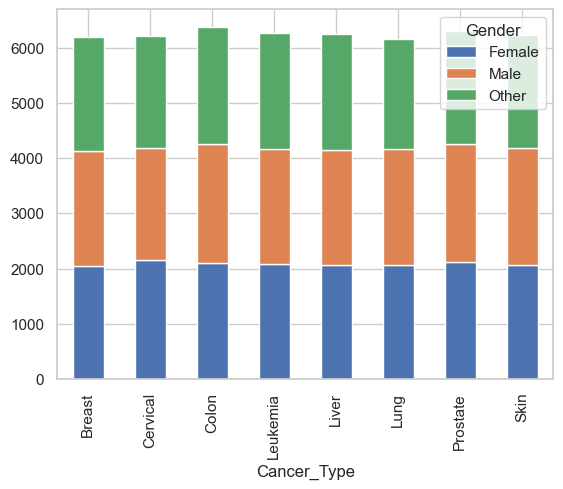

In [101]:
gender_counts = df.groupby(['Cancer_Type', 'Gender']).size().unstack()
gender_counts.plot(kind='bar', stacked=True)

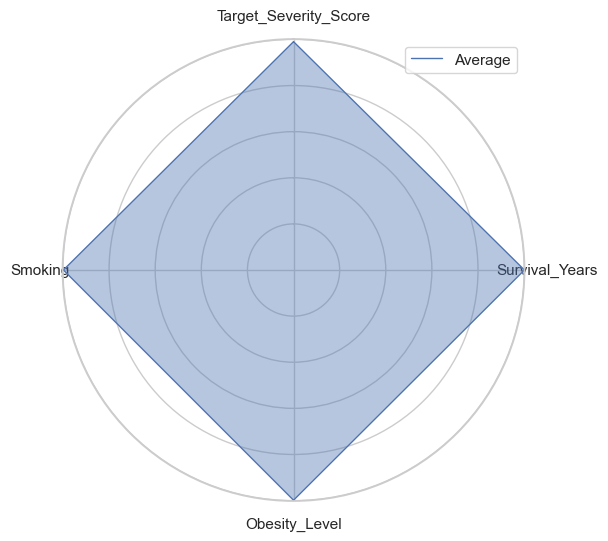

In [102]:
categories = ['Target_Severity_Score', 'Survival_Years', 'Obesity_Level', 'Smoking']
values = [
    df['Target_Severity_Score'].mean(),
    df['Survival_Years'].mean(),
    df['Obesity_Level'].mean(),
    df['Smoking'].mean()
]

# Radar chart
N = len(categories)
angles = [n / float(N) * 2 * pi for n in range(N)]
values += values[:1]           # repeat first value to close the loop
angles += angles[:1]

fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
ax.set_theta_offset(pi / 2)
ax.set_theta_direction(-1)

ax.plot(angles, values, linewidth=1, linestyle='solid', label='Average')
ax.fill(angles, values, alpha=0.4)

ax.set_yticklabels([])
ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)

plt.legend(loc='upper right')
plt.show()


In [103]:
import plotly.express as px

fig = px.treemap(df, path=['Country_Region', 'Gender'], values='Age')
fig.show()


In [104]:
import plotly.express as px

fig = px.treemap(df, path=['Country_Region', 'Gender'], values='Target_Severity_Score')
fig.show()


In [105]:
fig = px.treemap(df, path=['Cancer_Type', 'Gender'], values='Target_Severity_Score')
fig.show()

In [106]:
fig = px.treemap(df, path=['Cancer_Stage', 'Gender'], values='Target_Severity_Score')
fig.show()

In [107]:
fig = px.treemap(df, path=['Cancer_Stage', 'Cancer_Type'], values='Target_Severity_Score')
fig.show()

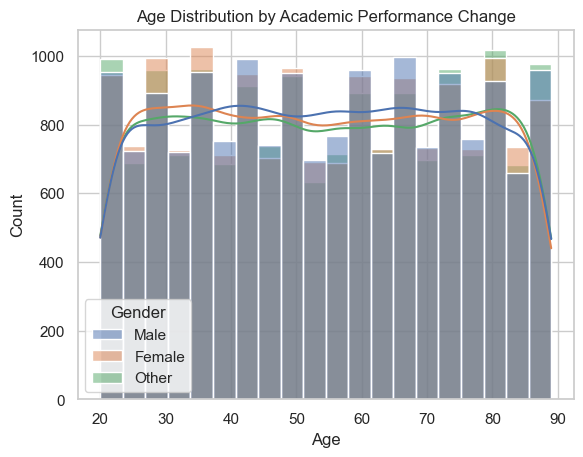

In [108]:
sns.histplot(data=df, x='Age', hue='Gender', kde=True, bins=20)
plt.title('Age Distribution by Academic Performance Change')
plt.show()

In [109]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,Male,UK,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,Male,China,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,Male,Pakistan,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,Male,UK,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,Female,Brazil,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


In [110]:
#Encoding

In [111]:
df['Gender'] = df['Gender'].map({'Male': 0, 'Female': 1,'Other':2})

In [112]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,0,UK,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,0,China,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,0,Pakistan,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,0,UK,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,1,Brazil,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


In [113]:
df['Country_Region'] = df['Country_Region'].map({'Australia':0,'UK':1,'USA':2,'India':3,'Germany':4,'Russia':5,'Brazil':6,'Pakistan':7,'China':8,'Canada':9})

In [114]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,0,1,2021,6.4,2.8,9.5,0.9,8.7,Lung,Stage III,62913.44,5.9,4.92
1,PT0000001,34,0,8,2021,1.3,4.5,3.7,3.9,6.3,Leukemia,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,0,7,2023,7.4,7.9,2.4,4.7,0.1,Breast,Stage II,6984.33,7.1,5.84
3,PT0000003,40,0,1,2015,1.7,2.9,4.8,3.5,2.7,Colon,Stage I,67446.25,1.6,3.12
4,PT0000004,43,1,6,2017,5.1,2.8,2.3,6.7,0.5,Skin,Stage III,77977.12,2.9,3.62


In [115]:
df['Cancer_Type'] = df['Cancer_Type'].map({'Colon':0,'Prostate':1,'Leukemia':2,'Liver':3,'Skin':4,'Cervical':5,'Breast':6,'Lung':7})

In [116]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,0,1,2021,6.4,2.8,9.5,0.9,8.7,7,Stage III,62913.44,5.9,4.92
1,PT0000001,34,0,8,2021,1.3,4.5,3.7,3.9,6.3,2,Stage 0,12573.41,4.7,4.65
2,PT0000002,80,0,7,2023,7.4,7.9,2.4,4.7,0.1,6,Stage II,6984.33,7.1,5.84
3,PT0000003,40,0,1,2015,1.7,2.9,4.8,3.5,2.7,0,Stage I,67446.25,1.6,3.12
4,PT0000004,43,1,6,2017,5.1,2.8,2.3,6.7,0.5,4,Stage III,77977.12,2.9,3.62


In [117]:
df['Cancer_Stage'] = df['Cancer_Stage'].map({'Stage 0':0,'Stage I':1,'Stage II':2,'Stage III':3,'Stage IV':4})

In [118]:
df.head()

,Patient_ID,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,PT0000000,71,0,1,2021,6.4,2.8,9.5,0.9,8.7,7,3,62913.44,5.9,4.92
1,PT0000001,34,0,8,2021,1.3,4.5,3.7,3.9,6.3,2,0,12573.41,4.7,4.65
2,PT0000002,80,0,7,2023,7.4,7.9,2.4,4.7,0.1,6,2,6984.33,7.1,5.84
3,PT0000003,40,0,1,2015,1.7,2.9,4.8,3.5,2.7,0,1,67446.25,1.6,3.12
4,PT0000004,43,1,6,2017,5.1,2.8,2.3,6.7,0.5,4,3,77977.12,2.9,3.62


In [119]:
df= df.drop(['Patient_ID'], axis=1)

In [120]:
df.head()

,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score
0,71,0,1,2021,6.4,2.8,9.5,0.9,8.7,7,3,62913.44,5.9,4.92
1,34,0,8,2021,1.3,4.5,3.7,3.9,6.3,2,0,12573.41,4.7,4.65
2,80,0,7,2023,7.4,7.9,2.4,4.7,0.1,6,2,6984.33,7.1,5.84
3,40,0,1,2015,1.7,2.9,4.8,3.5,2.7,0,1,67446.25,1.6,3.12
4,43,1,6,2017,5.1,2.8,2.3,6.7,0.5,4,3,77977.12,2.9,3.62


In [121]:
# segregating dataset into features i.e., X and target variables i.e., y
X = df.drop(['Cancer_Stage'], axis=1)
Y = df['Cancer_Stage']

In [122]:
import sklearn
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,test_size=0.20)

In [123]:
# Linear Regression

In [124]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Linear Regression model
model = LinearRegression()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Linear Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Linear Regression Metrics:
Mean Squared Error: 1.9738604385250098
Mean Absolute Error: 1.191905291391084
Mean Square Log Error: 0.338297623944224
Root Mean Squared Error: 1.4049414359769627
R-squared Value: -0.00032238023917807723
Adjusted R-squared Value: -0.0016246224726159664


In [125]:
# Ridge Regression

In [126]:
import numpy as np
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Ridge Regression model
model = Ridge()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Ridge Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Ridge Regression Metrics:
Mean Squared Error: 1.9738417416083218
Mean Absolute Error: 1.191768108158404
Mean Square Log Error: 0.33830633015031825
Root Mean Squared Error: 1.4049347819768438
R-squared Value: -0.00031290492682090054
Adjusted R-squared Value: -0.001615134825083242


In [127]:
# Lasso Regression

In [128]:
import numpy as np
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Lasso Regression model
model = Lasso()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Lasso Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Lasso Regression Metrics:
Mean Squared Error: 1.9733657942329275
Mean Absolute Error: 1.1882221408852587
Mean Square Log Error: 0.3382357144200757
Root Mean Squared Error: 1.4047653876120836
R-squared Value: -7.170205242790217e-05
Adjusted R-squared Value: -0.0013736179473489152


In [129]:
# Elastic Net

In [130]:
import numpy as np
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create an ElasticNet Regression model
model = ElasticNet()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("ElasticNet Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


ElasticNet Regression Metrics:
Mean Squared Error: 1.973365839825278
Mean Absolute Error: 1.1882246432391153
Mean Square Log Error: 0.3382356783291808
Root Mean Squared Error: 1.404765403839829
R-squared Value: -7.172515793607559e-05
Adjusted R-squared Value: -0.001373641082936361


In [131]:
#Polynomial Regression

In [132]:
import numpy as np
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Polynomial Regression model
poly_reg = PolynomialFeatures(degree=2)
X_poly_train = poly_reg.fit_transform(X_train)
X_poly_test = poly_reg.transform(X_test)
model = LinearRegression()
model.fit(X_poly_train, Y_train)

# Make predictions
Y_pred = model.predict(X_poly_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
#msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Polynomial Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
#print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)

Polynomial Regression Metrics:
Mean Squared Error: 1.9753304329161914
Mean Absolute Error: 1.1972497888622586
Root Mean Squared Error: 1.4054644900943571
R-squared Value: -0.0010673509876792941
Adjusted R-squared Value: -0.0023705630408377143


In [133]:
#Decision Tree

In [134]:
import numpy as np
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Decision Tree Regression model
model = DecisionTreeRegressor()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Decision Tree Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Decision Tree Regression Metrics:
Mean Squared Error: 4.0452
Mean Absolute Error: 1.6114
Mean Square Log Error: 0.657189138464703
Root Mean Squared Error: 2.0112682565983087
R-squared Value: -1.0500456939941105
Adjusted R-squared Value: -1.0527144897103056


In [135]:
# Random Forest Regressor

In [136]:
import numpy as np
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Assuming X and Y are defined
# Example definition for X and Y
# X = np.array([[feature1, feature2, ...], ...])
# Y = np.array([target1, target2, ...])

# Split the data
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.20, random_state=42)


# Create a Random Forest Regression model
model = RandomForestRegressor()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)

# Calculate adjusted R-squared
n = len(Y_test)
p = X_test.shape[1]
adjr2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)

print("Random Forest Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Squared Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Random Forest Regression Metrics:
Mean Squared Error: 2.00805116
Mean Absolute Error: 1.220762
Mean Squared Log Error: 0.3415814120427562
Root Mean Squared Error: 1.4170572183225347
R-squared Value: -0.01806446499814207
Adjusted R-squared Value: -0.019389804277630818


In [137]:
# Gradient Boosting Regressor

In [138]:
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Create a Gradient Boosting Regression model
model = GradientBoostingRegressor()

# Train the model
model.fit(X_train, Y_train)

# Make predictions
Y_pred = model.predict(X_test)

# Calculate metrics
mse = mean_squared_error(Y_test, Y_pred)
mae = mean_absolute_error(Y_test, Y_pred)
msle = mean_squared_log_error(Y_test, Y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(Y_test, Y_pred)
adjr2 = 1 - (1-r2)*(len(Y_test)-1)/(len(Y_test)-X_test.shape[1]-1)

print("Gradient Boosting Regression Metrics:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("Mean Square Log Error:", msle)
print("Root Mean Squared Error:", rmse)
print("R-squared Value:", r2)
print("Adjusted R-squared Value:", adjr2)


Gradient Boosting Regression Metrics:
Mean Squared Error: 1.9809357489591763
Mean Absolute Error: 1.2011376027913914
Mean Square Log Error: 0.33938410279332987
Root Mean Squared Error: 1.407457192584974
R-squared Value: -0.004317187546067247
Adjusted R-squared Value: -0.005624630309746248


In [139]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

best_random_state = None
best_metrics = {
    'mse': float('inf'),
    'mae': float('inf'),
    'msle': float('inf'),
    'rmse': float('inf'),
    'r2': -float('inf'),
    'adjr2': -float('inf')
}
for random_state in range(10):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.20, random_state=random_state)

    model = RandomForestRegressor()
    model.fit(X_train, Y_train)
    Y_pred = model.predict(X_test)

    mse = mean_squared_error(Y_test, Y_pred)
    mae = mean_absolute_error(Y_test, Y_pred)
    msle = mean_squared_log_error(Y_test, Y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(Y_test, Y_pred)
    adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

    if mse < best_metrics['mse']:
        best_metrics['mse'] = mse
        best_metrics['mae'] = mae
        best_metrics['msle'] = msle
        best_metrics['rmse'] = rmse
        best_metrics['r2'] = r2
        best_metrics['adjr2'] = adjr2
        best_random_state = random_state
print("Best Random State:", best_random_state)
print("Best Metrics:")
print("Mean Squared Error:", best_metrics['mse'])
print("Mean Absolute Error:", best_metrics['mae'])
print("Mean Squared Log Error:", best_metrics['msle'])
print("Root Mean Squared Error:", best_metrics['rmse'])
print("R-squared Value:", best_metrics['r2'])
print("Adjusted R-squared Value:", best_metrics['adjr2'])


Best Random State: 6
Best Metrics:
Mean Squared Error: 1.9789128100000002
Mean Absolute Error: 1.2042830000000002
Mean Squared Log Error: 0.3442756602946267
Root Mean Squared Error: 1.4067383587575908
R-squared Value: -0.019930001063010794
Adjusted R-squared Value: -0.021257768939419774


In [140]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Import models
from sklearn.linear_model import (
    LinearRegression, Ridge, Lasso, ElasticNet, LassoLars,
    OrthogonalMatchingPursuit, BayesianRidge, HuberRegressor,
    RANSACRegressor, TheilSenRegressor, PassiveAggressiveRegressor,
    SGDRegressor, TweedieRegressor
)
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import (
    RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor,
    ExtraTreesRegressor, BaggingRegressor, StackingRegressor,
    VotingRegressor, HistGradientBoostingRegressor
)
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR, LinearSVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.cross_decomposition import PLSRegression
from sklearn.dummy import DummyRegressor
from sklearn.kernel_ridge import KernelRidge

# Boosting libraries
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor


In [141]:
"""# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)

# Initialize models with random_state=3 where applicable
models = {
    "LinearRegression": LinearRegression(),
    "Ridge": Ridge(random_state=3),
    "Lasso": Lasso(random_state=3),
    "ElasticNet": ElasticNet(random_state=3),
    "LassoLars": LassoLars(),
    "OrthogonalMatchingPursuit": OrthogonalMatchingPursuit(),
    "BayesianRidge": BayesianRidge(),
    "HuberRegressor": HuberRegressor(),
    "RANSACRegressor": RANSACRegressor(random_state=3),
    "TheilSenRegressor": TheilSenRegressor(random_state=3),
    "PassiveAggressive": PassiveAggressiveRegressor(random_state=3),
    "SGDRegressor": SGDRegressor(random_state=3, max_iter=1000, tol=1e-3),
    "TweedieRegressor": TweedieRegressor(power=0),
    
    "DecisionTree": DecisionTreeRegressor(random_state=3),
    "RandomForest": RandomForestRegressor(random_state=3),
    "ExtraTrees": ExtraTreesRegressor(random_state=3),
    "GradientBoosting": GradientBoostingRegressor(random_state=3),
    "HistGradientBoosting": HistGradientBoostingRegressor(random_state=3),
    "AdaBoost": AdaBoostRegressor(random_state=3),
    "Bagging": BaggingRegressor(random_state=3),
    
    "VotingRegressor": VotingRegressor([('lr', LinearRegression()), ('rf', RandomForestRegressor(random_state=3))]),
    "StackingRegressor": StackingRegressor(
        estimators=[('ridge', Ridge()), ('rf', RandomForestRegressor(random_state=3))],
        final_estimator=LinearRegression()
    ),
    
    "KNeighbors": KNeighborsRegressor(),
    "SVR": SVR(),
    "LinearSVR": LinearSVR(max_iter=10000, random_state=3),
    "GaussianProcess": GaussianProcessRegressor(),
    "PLSRegression": PLSRegression(),
    "DummyRegressor": DummyRegressor(),
    "KernelRidge": KernelRidge(),

    # Boosting models
    "XGBoost": XGBRegressor(verbosity=0, random_state=3),
    "LightGBM": LGBMRegressor(random_state=3),
    "CatBoost": CatBoostRegressor(verbose=0, random_state=3)
}
"""

'# Split your data (ensure X and Y are already defined)\n# X, Y = ...\nX_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)\n\n# Initialize models with random_state=3 where applicable\nmodels = {\n    "LinearRegression": LinearRegression(),\n    "Ridge": Ridge(random_state=3),\n    "Lasso": Lasso(random_state=3),\n    "ElasticNet": ElasticNet(random_state=3),\n    "LassoLars": LassoLars(),\n    "OrthogonalMatchingPursuit": OrthogonalMatchingPursuit(),\n    "BayesianRidge": BayesianRidge(),\n    "HuberRegressor": HuberRegressor(),\n    "RANSACRegressor": RANSACRegressor(random_state=3),\n    "TheilSenRegressor": TheilSenRegressor(random_state=3),\n    "PassiveAggressive": PassiveAggressiveRegressor(random_state=3),\n    "SGDRegressor": SGDRegressor(random_state=3, max_iter=1000, tol=1e-3),\n    "TweedieRegressor": TweedieRegressor(power=0),\n\n    "DecisionTree": DecisionTreeRegressor(random_state=3),\n    "RandomForest": RandomForestRegressor(random_

In [142]:
# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=best_random_state)

# Initialize models with random_state=3 where applicable
models = {
    "LinearRegression": LinearRegression(),
    "Ridge": Ridge(random_state=best_random_state),
    "Lasso": Lasso(random_state=best_random_state),
    "ElasticNet": ElasticNet(random_state=best_random_state),
    "LassoLars": LassoLars(),
    "OrthogonalMatchingPursuit": OrthogonalMatchingPursuit(),
    "BayesianRidge": BayesianRidge(),
    "HuberRegressor": HuberRegressor(),
    "RANSACRegressor": RANSACRegressor(random_state=best_random_state),
    "TheilSenRegressor": TheilSenRegressor(random_state=best_random_state),
    "PassiveAggressive": PassiveAggressiveRegressor(random_state=best_random_state),
    "SGDRegressor": SGDRegressor(random_state=best_random_state, max_iter=1000, tol=1e-3),
    "TweedieRegressor": TweedieRegressor(power=0),
}


In [143]:
# Initialize results DataFrame
comp_ev = pd.DataFrame(columns=["Model", "MSE", "RMSE", "MAE", "MSLE", "R2", "Adjusted_R2"])

In [144]:
# Evaluate models
for name, model in models.items():
    try:
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)

        mse = mean_squared_error(Y_test, Y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(Y_test, Y_pred)
        msle = mean_squared_log_error(Y_test, np.maximum(Y_pred, 0))  # avoid log of negative
        r2 = r2_score(Y_test, Y_pred)
        adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

        comp_ev.loc[len(comp_ev)] = [name, mse, rmse, mae, msle, r2, adjr2]
    except Exception as e:
        print(f"{name} failed: {e}")

# Show sorted results
print(comp_ev.sort_values("R2", ascending=False).reset_index(drop=True))

                        Model           MSE          RMSE           MAE  \
0                       Ridge  1.942009e+00  1.393560e+00  1.176736e+00   
1               BayesianRidge  1.942014e+00  1.393562e+00  1.174187e+00   
2                   LassoLars  1.942125e+00  1.393601e+00  1.174080e+00   
3                       Lasso  1.942125e+00  1.393601e+00  1.174080e+00   
4                  ElasticNet  1.942126e+00  1.393602e+00  1.174080e+00   
5   OrthogonalMatchingPursuit  1.942127e+00  1.393602e+00  1.174080e+00   
6            TweedieRegressor  1.942242e+00  1.393644e+00  1.175554e+00   
7              HuberRegressor  1.942447e+00  1.393717e+00  1.174959e+00   
8            LinearRegression  1.942499e+00  1.393736e+00  1.177415e+00   
9           TheilSenRegressor  1.987330e+00  1.409727e+00  1.209318e+00   
10          PassiveAggressive  2.777861e+00  1.666692e+00  1.385304e+00   
11            RANSACRegressor  4.785195e+00  2.187509e+00  1.774474e+00   
12               SGDRegre

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning:

Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.

  File "C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 550, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 1028, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "C:\Users\

In [145]:
# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)

# Initialize models with random_state=3 where applicable
models = {
    "DecisionTree": DecisionTreeRegressor(random_state=3),
    "RandomForest": RandomForestRegressor(random_state=3),
    "ExtraTrees": ExtraTreesRegressor(random_state=3),
    "GradientBoosting": GradientBoostingRegressor(random_state=3),
    "HistGradientBoosting": HistGradientBoostingRegressor(random_state=3),
    "AdaBoost": AdaBoostRegressor(random_state=3),
    "Bagging": BaggingRegressor(random_state=3),
}
# Initialize results DataFrame
comp_ev = pd.DataFrame(columns=["Model", "MSE", "RMSE", "MAE", "MSLE", "R2", "Adjusted_R2"])
# Evaluate models
for name, model in models.items():
    try:
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)

        mse = mean_squared_error(Y_test, Y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(Y_test, Y_pred)
        msle = mean_squared_log_error(Y_test, np.maximum(Y_pred, 0))  # avoid log of negative
        r2 = r2_score(Y_test, Y_pred)
        adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

        comp_ev.loc[len(comp_ev)] = [name, mse, rmse, mae, msle, r2, adjr2]
    except Exception as e:
        print(f"{name} failed: {e}")

# Show sorted results
print(comp_ev.sort_values("R2", ascending=False).reset_index(drop=True))

                  Model       MSE      RMSE       MAE      MSLE        R2  \
0              AdaBoost  1.990669  1.410911  1.201193  0.342347 -0.000286   
1  HistGradientBoosting  1.990950  1.411010  1.203106  0.341638 -0.000427   
2      GradientBoosting  1.992397  1.411523  1.206480  0.342039 -0.001154   
3          RandomForest  2.020571  1.421468  1.227562  0.344909 -0.015311   
4            ExtraTrees  2.025689  1.423267  1.228131  0.345224 -0.017883   
5               Bagging  2.179511  1.476317  1.265210  0.359315 -0.095177   
6          DecisionTree  4.085900  2.021361  1.626500  0.663692 -1.053113   

   Adjusted_R2  
0    -0.001588  
1    -0.001730  
2    -0.002458  
3    -0.016633  
4    -0.019208  
5    -0.096602  
6    -1.055786  


In [146]:
# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)

# Initialize models with random_state=3 where applicable
models = {
    # Boosting models
    "XGBoost": XGBRegressor(verbosity=0, random_state=3),
    "LightGBM": LGBMRegressor(random_state=3),
    "CatBoost": CatBoostRegressor(verbose=0, random_state=3)
}
# Initialize results DataFrame
comp_ev = pd.DataFrame(columns=["Model", "MSE", "RMSE", "MAE", "MSLE", "R2", "Adjusted_R2"])
# Evaluate models
for name, model in models.items():
    try:
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)

        mse = mean_squared_error(Y_test, Y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(Y_test, Y_pred)
        msle = mean_squared_log_error(Y_test, np.maximum(Y_pred, 0))  # avoid log of negative
        r2 = r2_score(Y_test, Y_pred)
        adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

        comp_ev.loc[len(comp_ev)] = [name, mse, rmse, mae, msle, r2, adjr2]
    except Exception as e:
        print(f"{name} failed: {e}")

# Show sorted results
print(comp_ev.sort_values("R2", ascending=False).reset_index(drop=True))

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000515 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1219
[LightGBM] [Info] Number of data points in the train set: 40000, number of used features: 13
[LightGBM] [Info] Start training from score 2.001175
      Model       MSE      RMSE       MAE      MSLE        R2  Adjusted_R2
0  LightGBM  2.006177  1.416396  1.214931  0.343699 -0.008079    -0.009391
1  CatBoost  2.029928  1.424756  1.228690  0.345841 -0.020013    -0.021341
2   XGBoost  2.110440  1.452735  1.252377  0.353078 -0.060469    -0.061850


In [147]:
# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)

# Initialize models with random_state=3 where applicable
models = {
    "VotingRegressor": VotingRegressor([('lr', LinearRegression()), ('rf', RandomForestRegressor(random_state=3))]),
    "StackingRegressor": StackingRegressor(
        estimators=[('ridge', Ridge()), ('rf', RandomForestRegressor(random_state=3))],
        final_estimator=LinearRegression()
    ),
}
# Initialize results DataFrame
comp_ev = pd.DataFrame(columns=["Model", "MSE", "RMSE", "MAE", "MSLE", "R2", "Adjusted_R2"])
# Evaluate models
for name, model in models.items():
    try:
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)

        mse = mean_squared_error(Y_test, Y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(Y_test, Y_pred)
        msle = mean_squared_log_error(Y_test, np.maximum(Y_pred, 0))  # avoid log of negative
        r2 = r2_score(Y_test, Y_pred)
        adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

        comp_ev.loc[len(comp_ev)] = [name, mse, rmse, mae, msle, r2, adjr2]
    except Exception as e:
        print(f"{name} failed: {e}")

# Show sorted results
print(comp_ev.sort_values("R2", ascending=False).reset_index(drop=True))

               Model       MSE      RMSE       MAE      MSLE        R2  \
0  StackingRegressor  1.990513  1.410856  1.199540  0.341902 -0.000208   
1    VotingRegressor  1.995928  1.412773  1.212925  0.342465 -0.002928   

   Adjusted_R2  
0    -0.001510  
1    -0.004234  


In [148]:
# Split your data (ensure X and Y are already defined)
# X, Y = ...
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=3)

# Initialize models with random_state=3 where applicable
models = {
    "KNeighbors": KNeighborsRegressor(),
    "SVR": SVR(),
    "LinearSVR": LinearSVR(max_iter=10000, random_state=3),
}
# Initialize results DataFrame
comp_ev = pd.DataFrame(columns=["Model", "MSE", "RMSE", "MAE", "MSLE", "R2", "Adjusted_R2"])
# Evaluate models
for name, model in models.items():
    try:
        model.fit(X_train, Y_train)
        Y_pred = model.predict(X_test)

        mse = mean_squared_error(Y_test, Y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(Y_test, Y_pred)
        msle = mean_squared_log_error(Y_test, np.maximum(Y_pred, 0))  # avoid log of negative
        r2 = r2_score(Y_test, Y_pred)
        adjr2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

        comp_ev.loc[len(comp_ev)] = [name, mse, rmse, mae, msle, r2, adjr2]
    except Exception as e:
        print(f"{name} failed: {e}")

# Show sorted results
print(comp_ev.sort_values("R2", ascending=False).reset_index(drop=True))

        Model       MSE      RMSE       MAE      MSLE        R2  Adjusted_R2
0         SVR  1.998678  1.413746  1.210962  0.342544 -0.004310    -0.005618
1   LinearSVR  2.046934  1.430711  1.236397  0.345744 -0.028558    -0.029897
2  KNeighbors  2.417720  1.554902  1.318200  0.389330 -0.214874    -0.216455


C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\svm\_base.py:1249: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



In [149]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from xgboost import XGBClassifier

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [150]:
target = 'Cancer_Stage'
features = ['Age', 'Genetic_Risk', 'Air_Pollution', 'Alcohol_Use', 'Smoking', 'Obesity_Level', 'Treatment_Cost_USD']
categorical_features = ['Gender', 'Country_Region', 'Cancer_Type', 'Target_Severity_Score']

# Bin continuous target into classes (e.g., 0: Low, 1: Medium, 2: High)
def bin_severity(score):
    if score <= 3:
        return 0  # Low
    elif score <= 6:
        return 1  # Medium
    else:
        return 2  # High

df['Severity_Class'] = df[target].apply(bin_severity)

# Update target to classification
target_class = 'Severity_Class'

# Split data
X = df[features + categorical_features]
y = df[target_class]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessor for numeric and categorical features
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ]
)


----- RandomForest -----
Accuracy: 0.805
Classification Report:
               precision    recall  f1-score   support

           0       0.80      1.00      0.89      8049
           1       0.00      0.00      0.00      1951

    accuracy                           0.80     10000
   macro avg       0.40      0.50      0.45     10000
weighted avg       0.65      0.80      0.72     10000



C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



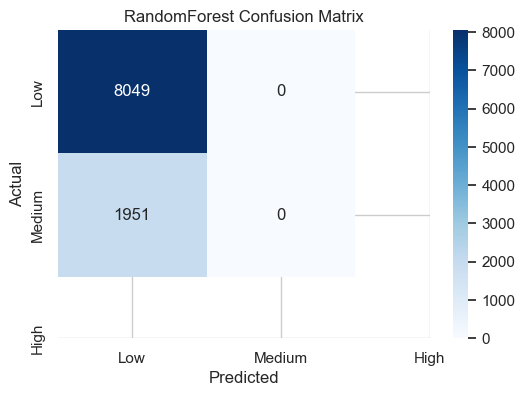


----- LogisticRegression -----
Accuracy: 0.805
Classification Report:
               precision    recall  f1-score   support

           0       0.80      1.00      0.89      8049
           1       0.00      0.00      0.00      1951

    accuracy                           0.80     10000
   macro avg       0.40      0.50      0.45     10000
weighted avg       0.65      0.80      0.72     10000



C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted

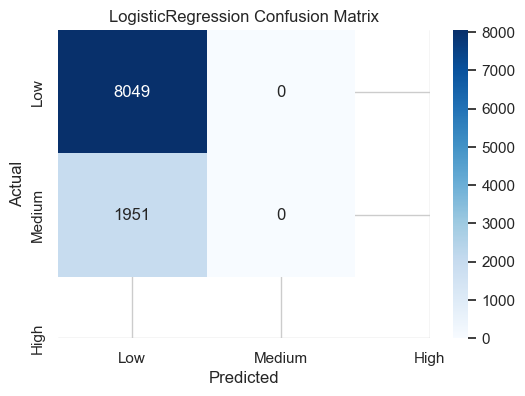


----- XGBoost -----


C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning:

[15:42:47] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.




Accuracy: 0.803
Classification Report:
               precision    recall  f1-score   support

           0       0.81      1.00      0.89      8049
           1       0.24      0.00      0.01      1951

    accuracy                           0.80     10000
   macro avg       0.52      0.50      0.45     10000
weighted avg       0.70      0.80      0.72     10000



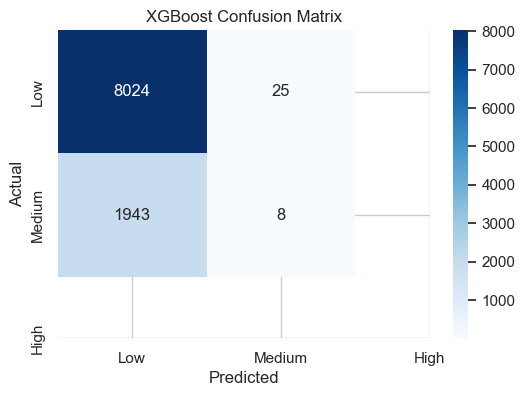


----- GradientBoosting -----
Accuracy: 0.805
Classification Report:
               precision    recall  f1-score   support

           0       0.80      1.00      0.89      8049
           1       0.33      0.00      0.00      1951

    accuracy                           0.80     10000
   macro avg       0.57      0.50      0.45     10000
weighted avg       0.71      0.80      0.72     10000



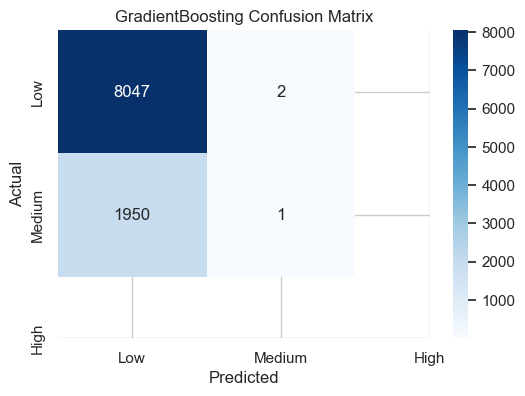


----- SVC -----
Accuracy: 0.805
Classification Report:
               precision    recall  f1-score   support

           0       0.80      1.00      0.89      8049
           1       0.00      0.00      0.00      1951

    accuracy                           0.80     10000
   macro avg       0.40      0.50      0.45     10000
weighted avg       0.65      0.80      0.72     10000



C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\muham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



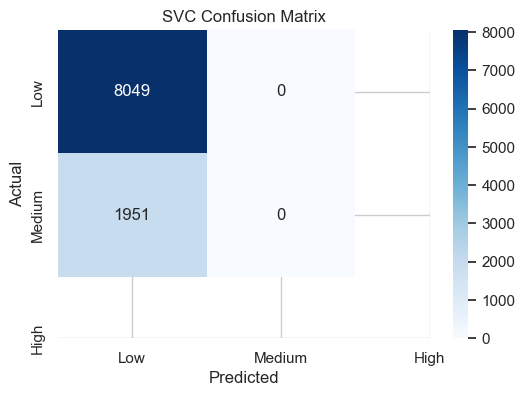

In [151]:
classifiers = {
    'RandomForest': RandomForestClassifier(n_estimators=100, random_state=42),
    'LogisticRegression': LogisticRegression(max_iter=1000, random_state=42),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42),
    'GradientBoosting': GradientBoostingClassifier(random_state=42),
    'SVC': SVC(probability=True, random_state=42)
}

# Loop through classifiers
for name, clf in classifiers.items():
    print(f"\n----- {name} -----")
    
    # Build pipeline
    model = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('classifier', clf)
    ])
    
    # Train
    model.fit(X_train, y_train)
    
    # Predict
    y_pred = model.predict(X_test)
    
    # Evaluate
    acc = accuracy_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    report = classification_report(y_test, y_pred)
    
    print(f"Accuracy: {acc:.3f}")
    print("Classification Report:\n", report)
    
    # Plot confusion matrix
    plt.figure(figsize=(6,4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Low', 'Medium', 'High'], yticklabels=['Low', 'Medium', 'High'])
    plt.title(f"{name} Confusion Matrix")
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.show()

In [152]:
import joblib
print(f"\n----- {name} -----")

# Build pipeline
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', clf)
])

# Train
model.fit(X_train, y_train)

# Save XGBoost model
if name == 'XGBoost':
    xgboost_model = model
    joblib.dump(xgboost_model, 'cancer_stage_model.pkl')
    print("XGBoost model saved as 'cancer_stage_model.pkl'")
# Save XGBoost model
if name == 'SVC':
    SVC_model = model
    joblib.dump(SVC_model, 'cancer_stage_model.pkl')
    print("SVC model saved as 'cancer_stage_model.pkl'")


----- SVC -----
SVC model saved as 'cancer_stage_model.pkl'


In [153]:
df.head()

,Age,Gender,Country_Region,Year,Genetic_Risk,Air_Pollution,Alcohol_Use,Smoking,Obesity_Level,Cancer_Type,Cancer_Stage,Treatment_Cost_USD,Survival_Years,Target_Severity_Score,Severity_Class
0,71,0,1,2021,6.4,2.8,9.5,0.9,8.7,7,3,62913.44,5.9,4.92,0
1,34,0,8,2021,1.3,4.5,3.7,3.9,6.3,2,0,12573.41,4.7,4.65,0
2,80,0,7,2023,7.4,7.9,2.4,4.7,0.1,6,2,6984.33,7.1,5.84,0
3,40,0,1,2015,1.7,2.9,4.8,3.5,2.7,0,1,67446.25,1.6,3.12,0
4,43,1,6,2017,5.1,2.8,2.3,6.7,0.5,4,3,77977.12,2.9,3.62,0
